In [1]:
import scanpy as sc
import scvelo as scv
%matplotlib inline

import scanpy as sc
import anndata as ad
import scanpy.external as sce
import numpy as np
import seaborn as sb
import seaborn as sns
import matplotlib.pyplot as plt
from matplotlib import rcParams
from matplotlib import colors
import matplotlib
import pandas as pd
from gprofiler import GProfiler
import os
import gseapy as gp2
import scrublet as scr
from scipy.sparse import csr_matrix
from time import time
import celltypist
from celltypist import models

import numpy as np

from scipy.stats import chisquare
from scipy import stats

import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.backends.backend_pdf import PdfPages


sc.settings.verbosity = 3             # verbosity: errors (0), warnings (1), info (2), hints (3)
# settings for the plots
sc.set_figure_params(scanpy=True, dpi=80, dpi_save=250,
                     frameon=True, vector_friendly=True,
                     color_map="YlGnBu", format='pdf', transparent=False,
                     ipython_format='png2x')

def top_marker_as_xlsx(adata, key_rank_genes, key_groups, output_file):
    
    print(adata.uns[key_rank_genes].keys())
    dict_genes = adata.uns[key_rank_genes].copy()
    print(dict_genes['params'])
    tmp = list(set(adata.obs[key_groups]))
    if dict_genes['params']['reference'] != 'rest':
        tmp.remove(dict_genes['params']['reference'])
    print(tmp, type(tmp))
    del dict_genes['params']
    clusters = sorted(tmp)*len(dict_genes['scores'])
    for key, value in dict_genes.items():
        tmp_list = []
        for n in value:
            tmp_list = tmp_list + list(n)
        dict_genes[key] = tmp_list
    
    dict_genes['cluster'] = clusters
    dataframe = pd.DataFrame(dict_genes)
    dataframe.to_excel(output_file)
    return(dataframe)

def top_marker_as_csv(adata, key_rank_genes, key_groups, output_file):
    
    print(adata.uns[key_rank_genes].keys())
    dict_genes = adata.uns[key_rank_genes].copy()
    print(dict_genes['params'])
    tmp = list(set(adata.obs[key_groups]))
    if dict_genes['params']['reference'] != 'rest':
        tmp.remove(dict_genes['params']['reference'])
    print(tmp, type(tmp))
    del dict_genes['params']
    clusters = sorted(tmp)*len(dict_genes['scores'])
    for key, value in dict_genes.items():
        tmp_list = []
        for n in value:
            tmp_list = tmp_list + list(n)
        dict_genes[key] = tmp_list
    
    dict_genes['cluster'] = clusters
    dataframe = pd.DataFrame(dict_genes)
    dataframe.to_csv(output_file)
    return(dataframe)

def make_boxplots(adata, genes, group_by, save=False):
    for curr_gene in genes:
        
        if type(genes) == str:
            genes = [genes]
        # extract the gene of interest
        index = 0
        for gene_name in adata.var_names.tolist():
            if curr_gene in gene_name:
                adata.obs[curr_gene] = adata.X[:,index]#.todense() 
            index += 1
         
        # make the plot
        ax = sns.boxplot(x=group_by, y=curr_gene, data=adata.obs)
        del adata.obs[curr_gene]
        
        # saving the plot
        if save:
            output_file_name = curr_gene+"_boxplot.png"
            output_directory = os.getcwd()+'/figures'
            # create output directory if it doesn't exist
            if not os.path.exists(output_directory):
                os.makedirs(output_directory)
            # save the boxplot
            plt.savefig(os.path.join(output_directory, output_file_name))
            
        # show the plot
        plt.show()
        
def scale_data_5_75(data):
    mind = np.min(data)
    maxd = np.max(data)
    
    if maxd == mind:
        maxd=maxd+1
        mind=mind-1
        
    drange = maxd - mind
    return ((((data - mind)/drange*0.70)+0.05)*100)


def plot_enrich(data, n_terms=20, save=False):
    # Test data input
    if not isinstance(data, pd.DataFrame):
        raise ValueError('Please input a Pandas Dataframe output by gprofiler.')
        
    if not np.all([term in data.columns for term in ['p_value', 'name', 'intersection_size']]):
        raise TypeError('The data frame {} does not contain enrichment results from gprofiler.'.format(data))
    
    data_to_plot = data.iloc[:n_terms,:].copy()
    data_to_plot['go.id'] = data_to_plot.index

    min_pval = data_to_plot['p_value'].min()
    max_pval = data_to_plot['p_value'].max()
    
    # Scale intersection_size to be between 5 and 75 for plotting
    #Note: this is done as calibration was done for values between 5 and 75
    data_to_plot['scaled.overlap'] = scale_data_5_75(data_to_plot['intersection_size'])
    
    norm = colors.LogNorm(min_pval, max_pval)
    sm = plt.cm.ScalarMappable(cmap="cool", norm=norm)
    sm.set_array([])

    rcParams.update({'font.size': 14, 'font.weight': 'bold'})

    sns.set(style="whitegrid")

    path = plt.scatter(x='recall', y="name", c='p_value', cmap='cool', 
                       norm=colors.LogNorm(min_pval, max_pval), 
                       data=data_to_plot, linewidth=1, edgecolor="grey", 
                       s=[(i+10)**1.5 for i in data_to_plot['scaled.overlap']])
    ax = plt.gca()
    ax.invert_yaxis()

    ax.set_ylabel('')
    ax.set_xlabel('Gene ratio', fontsize=14, fontweight='bold')
    ax.xaxis.grid(False)
    ax.yaxis.grid(True)

    # Shrink current axis by 20%
    box = ax.get_position()
    ax.set_position([box.x0, box.y0, box.width * 0.8, box.height])

    # Get tick marks for this plot
    #Note: 6 ticks maximum
    min_tick = np.floor(np.log10(min_pval)).astype(int)
    max_tick = np.ceil(np.log10(max_pval)).astype(int)
    tick_step = np.ceil((max_tick - min_tick)/6).astype(int)
    
    # Ensure no 0 values
    if tick_step == 0:
        tick_step = 1
        min_tick = max_tick-1
    
    ticks_vals = [10**i for i in range(max_tick, min_tick-1, -tick_step)]
    ticks_labs = ['$10^{'+str(i)+'}$' for i in range(max_tick, min_tick-1, -tick_step)]

    #Colorbar
    fig = plt.gcf()
    cbaxes = fig.add_axes([0.8, 0.15, 0.03, 0.4])
    cbar = ax.figure.colorbar(sm, ticks=ticks_vals, shrink=0.5, anchor=(0,0.1), cax=cbaxes)
    cbar.ax.set_yticklabels(ticks_labs)
    cbar.set_label("Adjusted p-value", fontsize=14, fontweight='bold')

    #Size legend
    min_olap = data_to_plot['intersection_size'].min()
    max_olap = data_to_plot['intersection_size'].max()
    olap_range = max_olap - min_olap
    
    #Note: approximate scaled 5, 25, 50, 75 values are calculated
    #      and then rounded to nearest number divisible by 5
    size_leg_vals = [np.round(i/5)*5 for i in 
                          [min_olap, min_olap+(20/70)*olap_range, min_olap+(45/70)*olap_range, max_olap]]
    size_leg_scaled_vals = scale_data_5_75(size_leg_vals)

    
    l1 = plt.scatter([],[], s=(size_leg_scaled_vals[0]+10)**1.5, edgecolors='none', color='black')
    l2 = plt.scatter([],[], s=(size_leg_scaled_vals[1]+10)**1.5, edgecolors='none', color='black')
    l3 = plt.scatter([],[], s=(size_leg_scaled_vals[2]+10)**1.5, edgecolors='none', color='black')
    l4 = plt.scatter([],[], s=(size_leg_scaled_vals[3]+10)**1.5, edgecolors='none', color='black')

    labels = [str(int(i)) for i in size_leg_vals]

    leg = plt.legend([l1, l2, l3, l4], labels, ncol=1, frameon=False, fontsize=12,
                     handlelength=1, loc = 'center left', borderpad = 1, labelspacing = 1.4,
                     handletextpad=2, title='Gene overlap', scatterpoints = 1,  bbox_to_anchor=(0.1, 1.5), 
                     facecolor='black')

    if save:
        plt.savefig(save, dpi=300, format='pdf', bbox_inches="tight")

    plt.show()

ModuleNotFoundError: No module named 'gprofiler'

# Load the raw data

In [2]:
adata = ad.read('all_raw_samples_velocity.h5ad')
adata.obs['cell_barcode_sample'] = [x.split('x')[0] for x in adata.obs_names.tolist()]
adata.obs

,sample,cell_barcode_sample
CellID,,
Sample1:AAAGGTATCGTGCAGCx-0-0-0-0-0-0-0,Sample1,Sample1:AAAGGTATCGTGCAGC
Sample1:AAAGAACGTGTGGACAx-0-0-0-0-0-0-0,Sample1,Sample1:AAAGAACGTGTGGACA
Sample1:AAAGGGCAGTCGAAATx-0-0-0-0-0-0-0,Sample1,Sample1:AAAGGGCAGTCGAAAT
Sample1:AAAGAACAGGCTATCTx-0-0-0-0-0-0-0,Sample1,Sample1:AAAGAACAGGCTATCT
Sample1:AAAGGATGTGGCTCTGx-0-0-0-0-0-0-0,Sample1,Sample1:AAAGGATGTGGCTCTG
...,...,...
Sample8:TTTCATGTCGCAGATTx-1,Sample8,Sample8:TTTCATGTCGCAGATT
Sample8:TTTGATCTCTGGTTGAx-1,Sample8,Sample8:TTTGATCTCTGGTTGA
Sample8:TTTGGTTGTCCATACAx-1,Sample8,Sample8:TTTGGTTGTCCATACA


In [3]:
# load the correct count
adata_tmp = ad.read('all_raw_samples_cellranger.h5ad')
# order the cols of the ct mtx to be in the same order
adata_tmp=adata_tmp[:,adata.var_names].copy()
#  rename the obs_names
adata_tmp.obs['cell_name']  =adata_tmp.obs_names.tolist()
new_name = []
index = 0
for name in adata_tmp.obs['cell_name']:
    new_name.append(':'.join([adata_tmp.obs['sample'][index], name.split('-')[0]]))
    index += 1
adata_tmp.obs_names = new_name
# order the rows of the ct mtx to be in the same order
adata_tmp=adata_tmp[adata.obs['cell_barcode_sample'],:].copy()
adata_tmp.obs

# save the original adata.X in a layer 
adata.layers['velocyto_all_count'] = adata.X.copy()
# replace the adata.X by the cellranger count (because they include mitochrondrial genes)
adata.X = adata_tmp.X.copy()
del adata_tmp

In [4]:
adata.layers['cellranger_count'] = adata.X.copy()
adata.X=adata.layers['velocyto_all_count'].copy()

In [5]:
adata

AnnData object with n_obs × n_vars = 68531 × 36601
    obs: 'sample', 'cell_barcode_sample'
    var: 'Accession', 'Chromosome', 'End', 'Start', 'Strand'
    layers: 'ambiguous', 'matrix', 'spliced', 'unspliced', 'velocyto_all_count', 'cellranger_count'

### rename samples

In [6]:
full_label = []
timepoint = []
for name in adata.obs['sample']:
    if name=="Sample1":
        full_label.append("1. undiff + Shield1 - day 0")
        timepoint.append('day 0')
    elif name=="Sample2":
        full_label.append("2. undiff + Shield1 - day 0")
        timepoint.append('day 0')
    elif name=="Sample3":
        full_label.append("3. undiff - day 2")
        timepoint.append('day 2')
    elif name=="Sample4":
        full_label.append("4. diff media - day 2")
        timepoint.append('day 2')
    elif name=="Sample5":
        full_label.append("5. diff media - day 5")
        timepoint.append('day 5')
    elif name=="Sample6":
        full_label.append("6. diff media - day 9")
        timepoint.append('day 9')
    elif name=="Sample7":
        full_label.append("7. diff media - day 12")
        timepoint.append('day 12')
    elif name=="Sample8":
        full_label.append("8. diff media - day 14")
        timepoint.append('day 14')
adata.obs['full_label'] = full_label
adata.obs['timepoint'] = timepoint

In [8]:
pd.crosstab(adata.obs['sample'], adata.obs['sample'])

sample,Sample1,Sample2,Sample3,Sample4,Sample5,Sample6,Sample7,Sample8
sample,,,,,,,,
Sample1,11377,0,0,0,0,0,0,0
Sample2,0,8957,0,0,0,0,0,0
Sample3,0,0,9040,0,0,0,0,0
Sample4,0,0,0,9351,0,0,0,0
Sample5,0,0,0,0,9588,0,0,0
Sample6,0,0,0,0,0,7858,0,0
Sample7,0,0,0,0,0,0,7605,0
Sample8,0,0,0,0,0,0,0,4755


In [7]:
adata.write('tmp_file.h5ad')

... storing 'full_label' as categorical
... storing 'timepoint' as categorical


# Run scrublet

In [9]:
sc.external.pp.scrublet(adata)

Running Scrublet
filtered out 14527 genes that are detected in less than 3 cells
normalizing counts per cell
    finished (0:00:00)
extracting highly variable genes
    finished (0:00:04)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)
normalizing counts per cell
    finished (0:00:00)
normalizing counts per cell
    finished (0:00:00)
Embedding transcriptomes using PCA...
Automatically set threshold at doublet score = 0.65
Detected doublet rate = 0.1%
Estimated detectable doublet fraction = 19.5%
Overall doublet rate:
	Expected   = 5.0%
	Estimated  = 0.5%
    Scrublet finished (0:02:37)


In [10]:
pd.crosstab(adata.obs['sample'], adata.obs['predicted_doublet'])

predicted_doublet,False,True
sample,,
Sample1,11376,1
Sample2,8955,2
Sample3,9038,2
Sample4,9346,5
Sample5,9583,5
Sample6,7836,22
Sample7,7582,23
Sample8,4746,9


In [11]:
# filtering out prdicted doublets
adata = adata[adata.obs['predicted_doublet']==False,:].copy()
adata

AnnData object with n_obs × n_vars = 68462 × 36601
    obs: 'sample', 'cell_barcode_sample', 'full_label', 'timepoint', 'doublet_score', 'predicted_doublet'
    var: 'Accession', 'Chromosome', 'End', 'Start', 'Strand'
    uns: 'scrublet'
    layers: 'ambiguous', 'matrix', 'spliced', 'unspliced', 'velocyto_all_count', 'cellranger_count'

In [12]:
adata.write('tmp_point_post_scrublet.h5ad')

# QC and filtering

In [13]:
adata = ad.read('tmp_point_post_scrublet.h5ad')
adata

AnnData object with n_obs × n_vars = 68462 × 36601
    obs: 'sample', 'cell_barcode_sample', 'full_label', 'timepoint', 'doublet_score', 'predicted_doublet'
    var: 'Accession', 'Chromosome', 'End', 'Start', 'Strand'
    uns: 'scrublet'
    layers: 'ambiguous', 'cellranger_count', 'matrix', 'spliced', 'unspliced', 'velocyto_all_count'

saving figure to file ./figures/scvelo_proportions_velocyt_QC_check_splicing.png


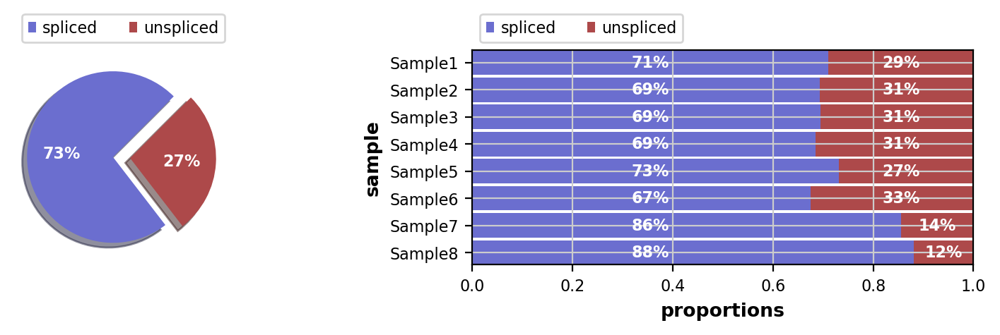

saving figure to file ./figures/scvelo_proportions_velocyt_QC_check_splicing.pdf
saving figure to file ./figures/scvelo_proportions_velocyt_QC_check_splicing.svg


[<Axes: >, <Axes: xlabel='proportions', ylabel='sample'>]

In [14]:
scv.pl.proportions(adata, groupby='sample', save="velocyt_QC_check_splicing.png")
scv.pl.proportions(adata, groupby='sample', save="velocyt_QC_check_splicing.pdf", show=False)
scv.pl.proportions(adata, groupby='sample', save="velocyt_QC_check_splicing.svg", show=False)

In [15]:
pd.crosstab(adata.obs['sample'], adata.obs['sample'])

sample,Sample1,Sample2,Sample3,Sample4,Sample5,Sample6,Sample7,Sample8
sample,,,,,,,,
Sample1,11376,0,0,0,0,0,0,0
Sample2,0,8955,0,0,0,0,0,0
Sample3,0,0,9038,0,0,0,0,0
Sample4,0,0,0,9346,0,0,0,0
Sample5,0,0,0,0,9583,0,0,0
Sample6,0,0,0,0,0,7836,0,0
Sample7,0,0,0,0,0,0,7582,0
Sample8,0,0,0,0,0,0,0,4746


In [16]:
# Quality control - calculate QC covariates
adata.obs['n_counts'] = adata.X.sum(1)
adata.obs['log_counts'] = np.log(adata.obs['n_counts'])
adata.obs['n_genes'] = (adata.X > 0).sum(1)
adata.var['n_cells'] = adata.X.sum(0).tolist()[0]

### Sample quality plots

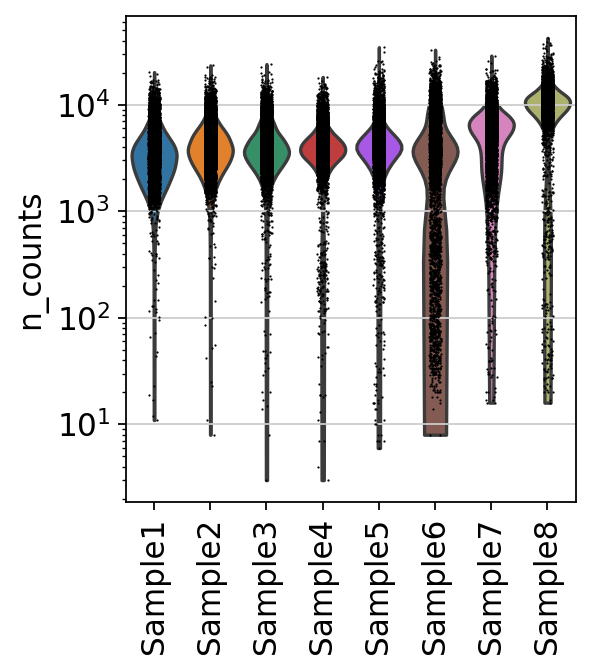

In [17]:
t1 = sc.pl.violin(adata, 'n_counts', groupby='sample', size=1, log=True, cut=0, rotation=90,
                 save="_counts_per_sample.png")
t1 = sc.pl.violin(adata, 'n_counts', groupby='sample', size=1, log=True, cut=0, rotation=90,
                 save="_counts_per_sample.pdf", show=False)
t1 = sc.pl.violin(adata, 'n_counts', groupby='sample', size=1, log=True, cut=0, rotation=90,
                 save="_counts_per_sample.svg", show=False)


In [18]:
mt_gene_mask = ['M'==gene for gene in adata.var['Chromosome']]
adata.obs['cellranger_n_counts'] = [x[0] for x in adata.layers['cellranger_count'].sum(1).tolist()]
adata.obs['mt_frac'] = [x[0] for x in adata.layers['cellranger_count'][:, mt_gene_mask].sum(1).tolist()]/adata.obs['cellranger_n_counts']
adata

AnnData object with n_obs × n_vars = 68462 × 36601
    obs: 'sample', 'cell_barcode_sample', 'full_label', 'timepoint', 'doublet_score', 'predicted_doublet', 'n_counts', 'log_counts', 'n_genes', 'cellranger_n_counts', 'mt_frac'
    var: 'Accession', 'Chromosome', 'End', 'Start', 'Strand', 'n_cells'
    uns: 'scrublet', 'sample_colors'
    layers: 'ambiguous', 'cellranger_count', 'matrix', 'spliced', 'unspliced', 'velocyto_all_count'

In [19]:
sc.pp.calculate_qc_metrics(adata, percent_top=None, log1p=False, inplace=True)
adata

AnnData object with n_obs × n_vars = 68462 × 36601
    obs: 'sample', 'cell_barcode_sample', 'full_label', 'timepoint', 'doublet_score', 'predicted_doublet', 'n_counts', 'log_counts', 'n_genes', 'cellranger_n_counts', 'mt_frac', 'n_genes_by_counts', 'total_counts'
    var: 'Accession', 'Chromosome', 'End', 'Start', 'Strand', 'n_cells', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts'
    uns: 'scrublet', 'sample_colors'
    layers: 'ambiguous', 'cellranger_count', 'matrix', 'spliced', 'unspliced', 'velocyto_all_count'

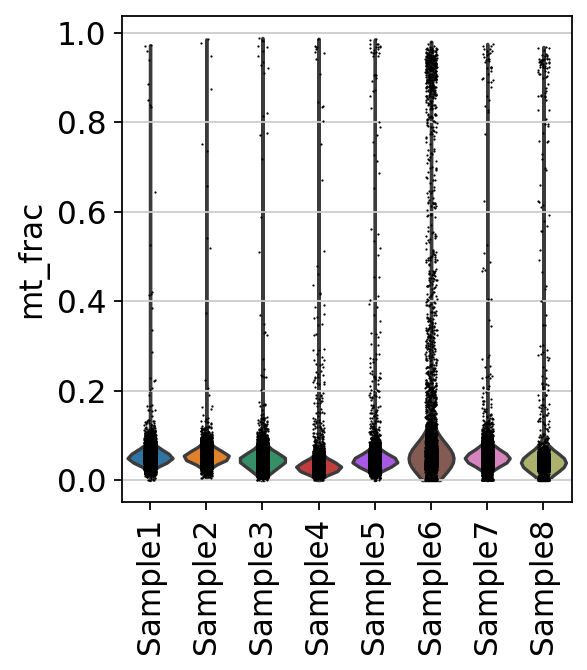

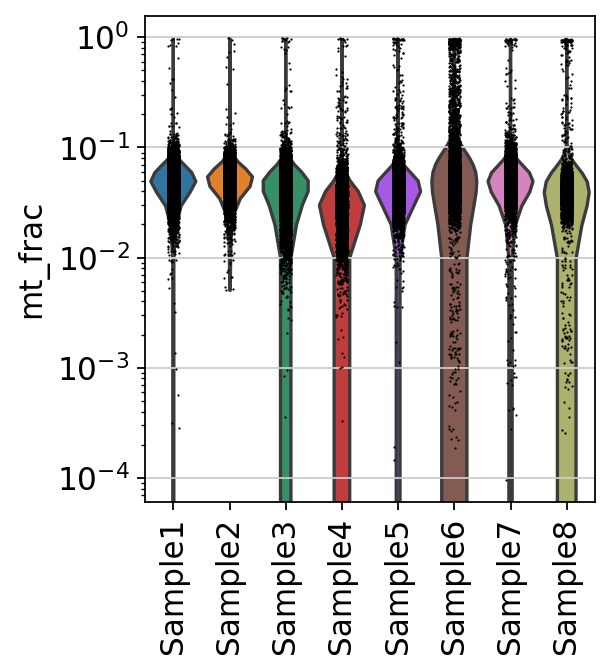

In [20]:
t2 = sc.pl.violin(adata, 'mt_frac', groupby='sample', rotation=90, save='_mt_counts_samples.png')
t2 = sc.pl.violin(adata, 'mt_frac', groupby='sample', rotation=90, log=True, save='_log_mt_counts_samples.png')

t2 = sc.pl.violin(adata, 'mt_frac', groupby='sample', rotation=90, save='_mt_counts_samples.pdf', show=False)
t2 = sc.pl.violin(adata, 'mt_frac', groupby='sample', rotation=90, log=True, save='_log_mt_counts_samples.pdf', show=False)

t2 = sc.pl.violin(adata, 'mt_frac', groupby='sample', rotation=90, save='_mt_counts_samples.svg', show=False)
t2 = sc.pl.violin(adata, 'mt_frac', groupby='sample', rotation=90, log=True, save='_log_mt_counts_samples.svg', show=False)

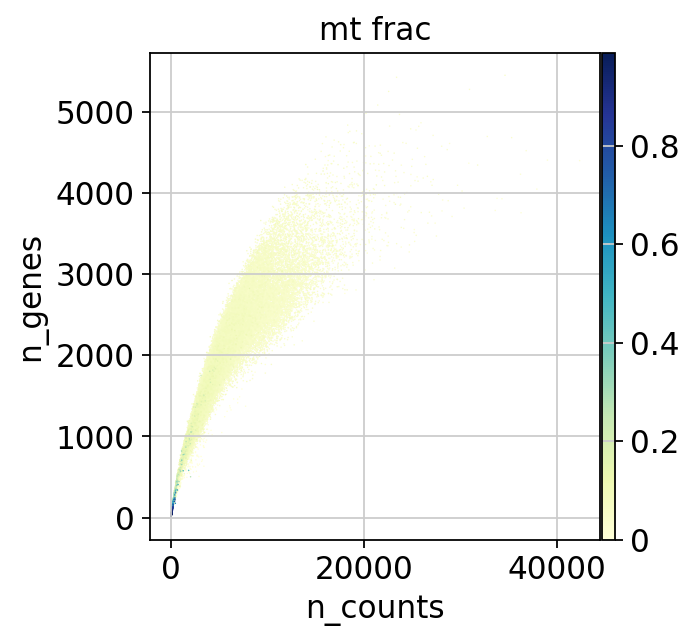

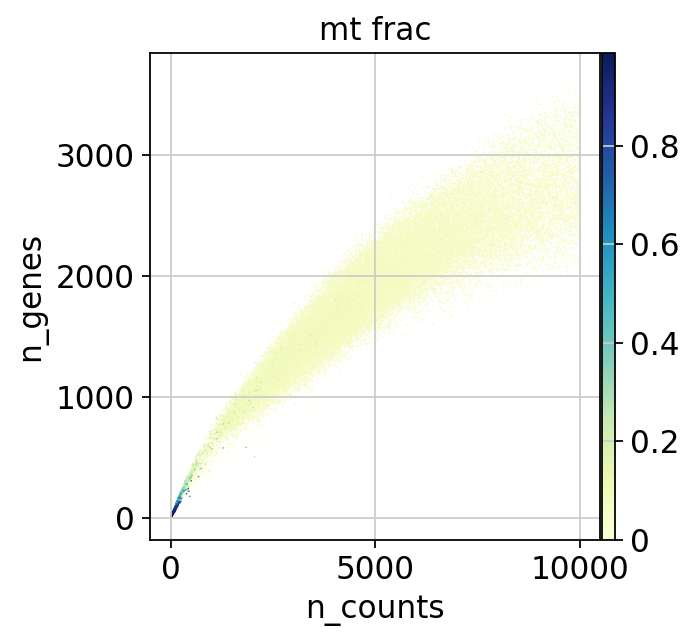

In [21]:
#Data quality summary plots
p1 = sc.pl.scatter(adata, 'n_counts', 'n_genes', color='mt_frac')
p2 = sc.pl.scatter(adata[adata.obs['n_counts']<10000], 'n_counts', 'n_genes', color='mt_frac')

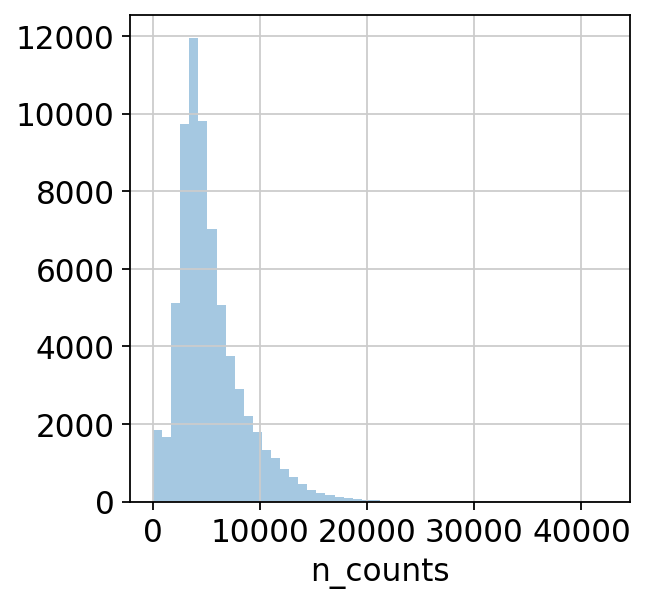

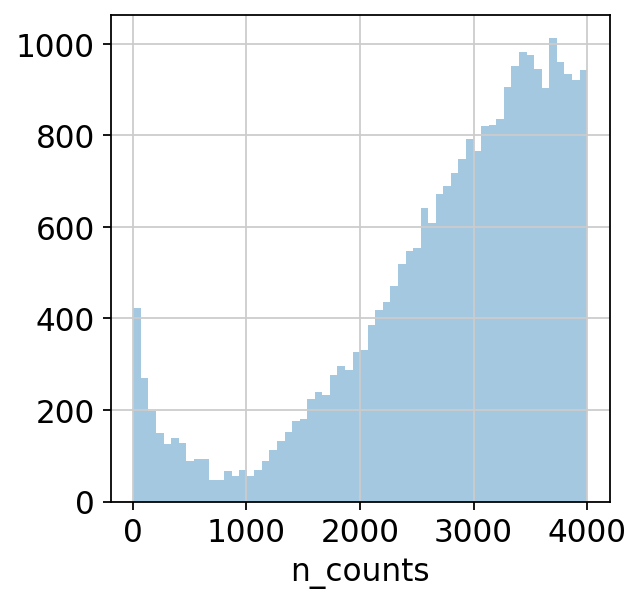

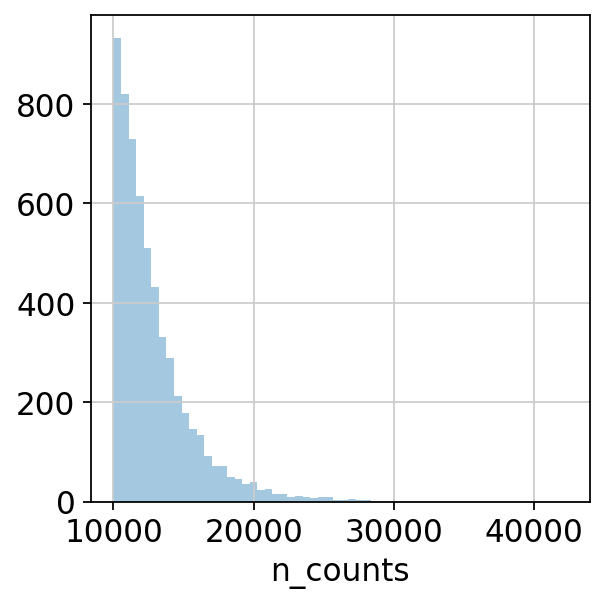

In [22]:
#Thresholding decision: counts
p3 = sb.distplot(adata.obs['n_counts'], kde=False)
plt.show()

p4 = sb.distplot(adata.obs['n_counts'][adata.obs['n_counts']<4000], kde=False, bins=60)
plt.show()

p5 = sb.distplot(adata.obs['n_counts'][adata.obs['n_counts']>10000], kde=False, bins=60)
plt.show()

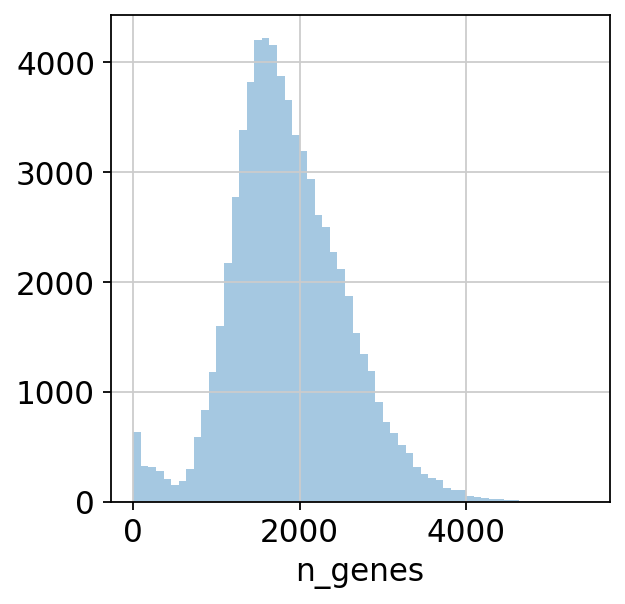

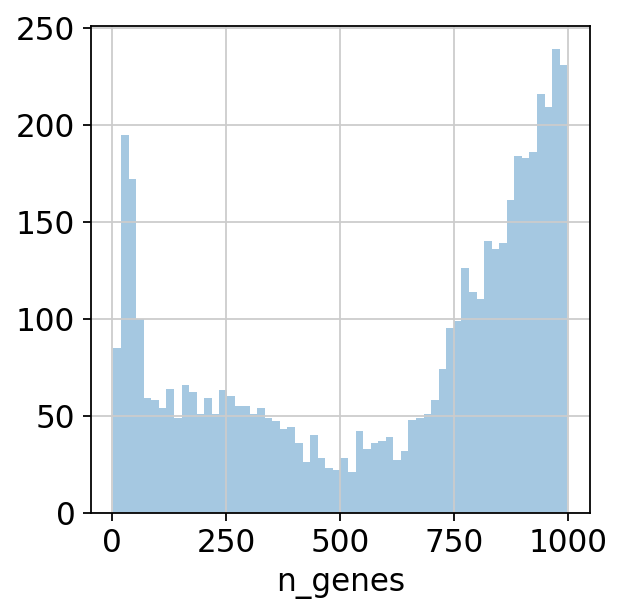

In [23]:
#Thresholding decision: genes
p6 = sb.distplot(adata.obs['n_genes'], kde=False, bins=60)
plt.show()

p7 = sb.distplot(adata.obs['n_genes'][adata.obs['n_genes']<1000], kde=False, bins=60)
plt.show()


In [24]:
#adata.write('tmp_file.h5ad')

In [2]:
adata = ad.read('tmp_file.h5ad')
adata

AnnData object with n_obs × n_vars = 68462 × 36601
    obs: 'sample', 'cell_barcode_sample', 'full_label', 'timepoint', 'doublet_score', 'predicted_doublet', 'n_counts', 'log_counts', 'n_genes', 'cellranger_n_counts', 'mt_frac', 'n_genes_by_counts', 'total_counts'
    var: 'Accession', 'Chromosome', 'End', 'Start', 'Strand', 'n_cells', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts'
    uns: 'sample_colors', 'scrublet'
    layers: 'ambiguous', 'cellranger_count', 'matrix', 'spliced', 'unspliced', 'velocyto_all_count'

# Filtering 

In [3]:
# Filter cells according to identified QC thresholds:
print('Total number of cells: {:d}'.format(adata.n_obs))

sc.pp.filter_cells(adata, min_counts = 1500)
print('Number of cells after min count filter: {:d}'.format(adata.n_obs))

adata = adata[adata.obs['mt_frac'] < 0.2]
print('Number of cells after MT filter: {:d}'.format(adata.n_obs))

sc.pp.filter_cells(adata, min_genes = 250)
print('Number of cells after gene filter: {:d}'.format(adata.n_obs))




Total number of cells: 68462
filtered out 2858 cells that have less than 1500 counts
Number of cells after min count filter: 65604
Number of cells after MT filter: 65587
Number of cells after gene filter: 65587


In [4]:
pd.crosstab(adata.obs['sample'], adata.obs['sample'])

sample,Sample1,Sample2,Sample3,Sample4,Sample5,Sample6,Sample7,Sample8
sample,,,,,,,,
Sample1,10959,0,0,0,0,0,0,0
Sample2,0,8842,0,0,0,0,0,0
Sample3,0,0,8876,0,0,0,0,0
Sample4,0,0,0,9139,0,0,0,0
Sample5,0,0,0,0,9321,0,0,0
Sample6,0,0,0,0,0,6669,0,0
Sample7,0,0,0,0,0,0,7238,0
Sample8,0,0,0,0,0,0,0,4543


# Top highly expressed genes

normalizing counts per cell
    finished (0:00:00)


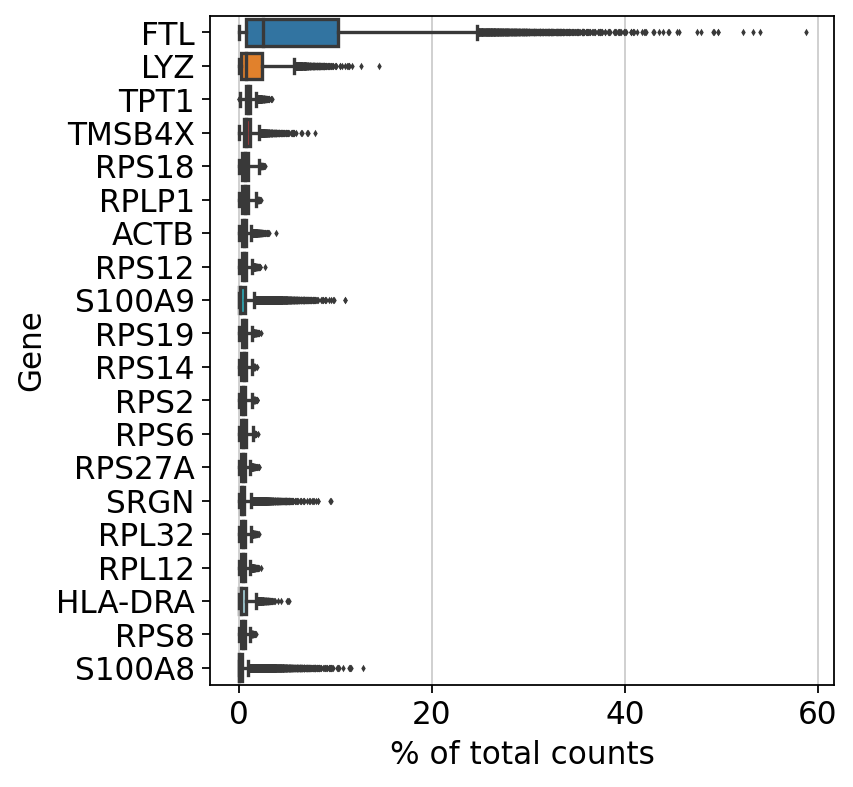

In [5]:
sc.pl.highest_expr_genes(adata, n_top=20, save="-all_samples.png")
#sc.pl.highest_expr_genes(adata, n_top=20, save="-all_samples.svg", show=False)
#sc.pl.highest_expr_genes(adata, n_top=20, save="-all_samples.pdf", show=False)
# AC068051 --> VWC2L von Willebrand factor C domain containing 2 like

# Post filtering QC

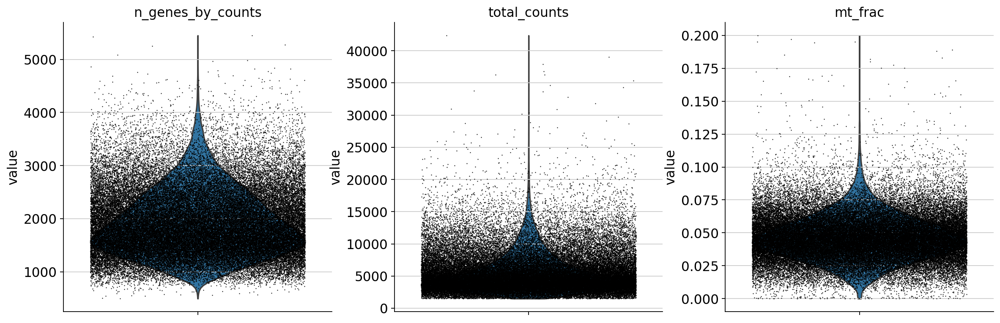

In [6]:
sc.pl.violin(adata, ['n_genes_by_counts', 'total_counts', 'mt_frac'],
             jitter=0.4, multi_panel=True, save="_post_filtering_qc.png")
sc.pl.violin(adata, ['n_genes_by_counts', 'total_counts', 'mt_frac'],
             jitter=0.4, multi_panel=True, save="_post_filtering_qc.pdf", show=False)
sc.pl.violin(adata, ['n_genes_by_counts', 'total_counts', 'mt_frac'],
             jitter=0.4, multi_panel=True, save="_post_filtering_qc.svg", show=False)

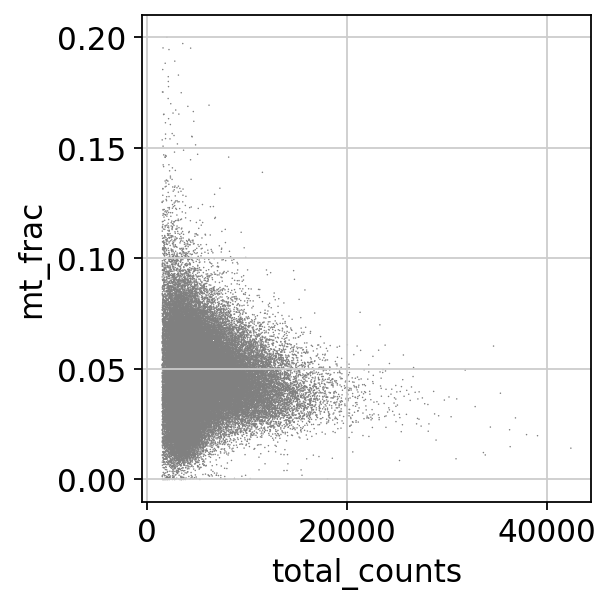

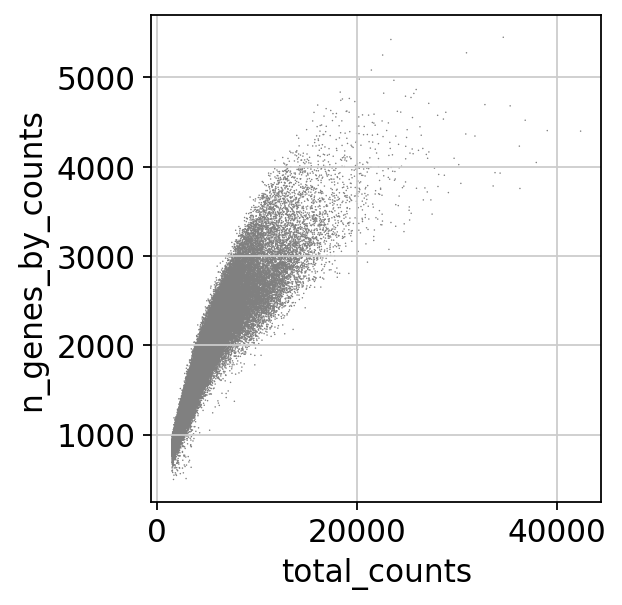

In [7]:
sc.pl.scatter(adata, x='total_counts', y='mt_frac')
sc.pl.scatter(adata, x='total_counts', y='n_genes_by_counts')

In [8]:
#adata.write('tmp_file2.h5ad')
adata = ad.read('tmp_file2.h5ad')

# Normalisation

In [9]:
adata.layers['raw_counts'] = adata.X

In [10]:
sc.pp.normalize_total(adata, target_sum=2e4)

normalizing counts per cell
    finished (0:00:00)


In [11]:
# log transform 
sc.pp.log1p(adata)


computing PCA
    with n_comps=50
    finished (0:00:50)


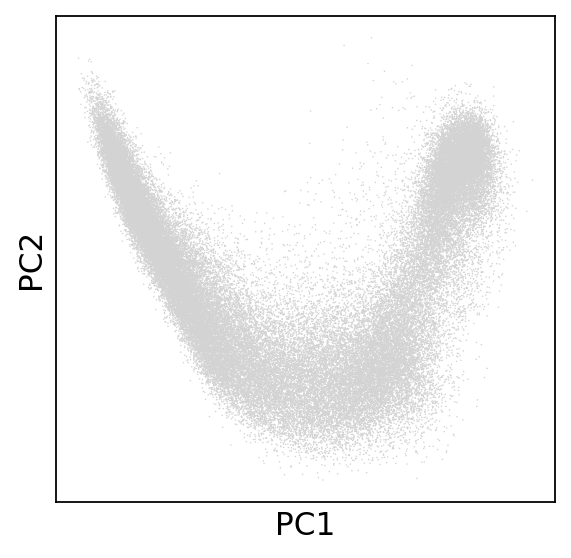

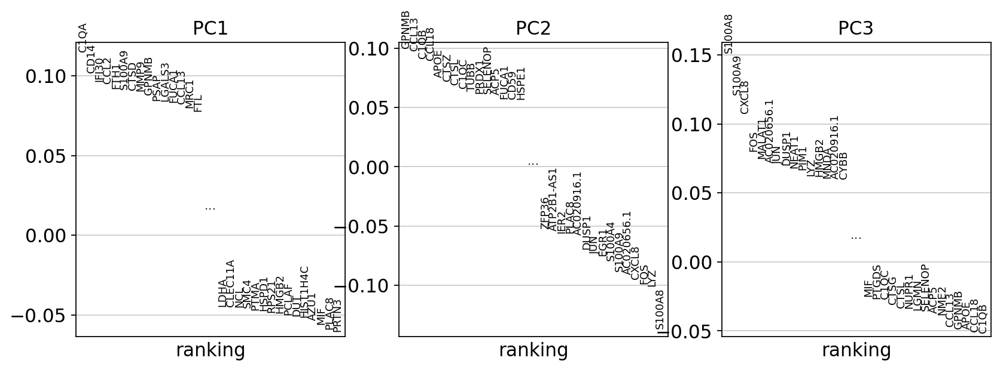

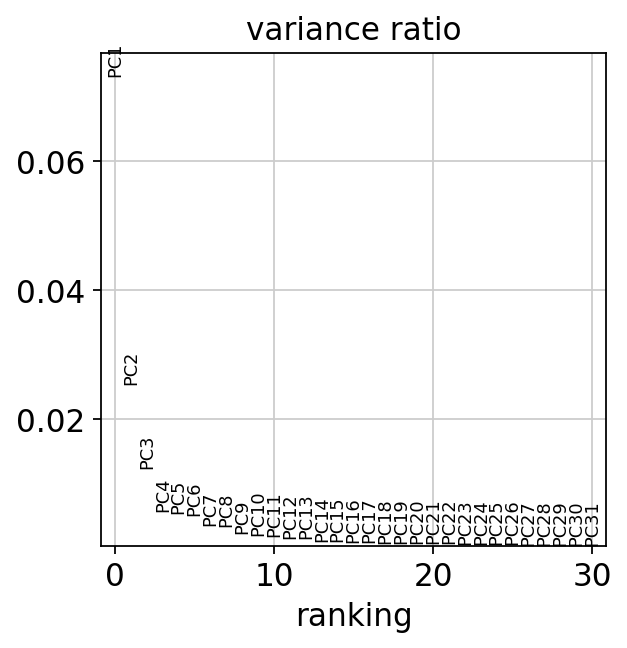

In [12]:
sc.pp.pca(adata)
sc.pl.pca_overview(adata)


In [13]:
sc.pp.neighbors(adata, n_pcs = 50)
sc.tl.umap(adata)
sc.tl.diffmap(adata)

computing neighbors
    using 'X_pca' with n_pcs = 50
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:13)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:26)
computing Diffusion Maps using n_comps=15(=n_dcs)
computing transitions
    finished (0:00:00)
    eigenvalues of transition matrix
    [1.         0.999093   0.99693984 0.99671996 0.9953179  0.9920509
     0.9894318  0.9872497  0.98337626 0.9825315  0.98194915 0.9806831
     0.97656685 0.9747893  0.9720572 ]
    finished: added
    'X_diffmap', diffmap coordinates (adata.obsm)
    'diffmap_evals', eigenvalues of transition matrix (adata.uns) (0:00:03)


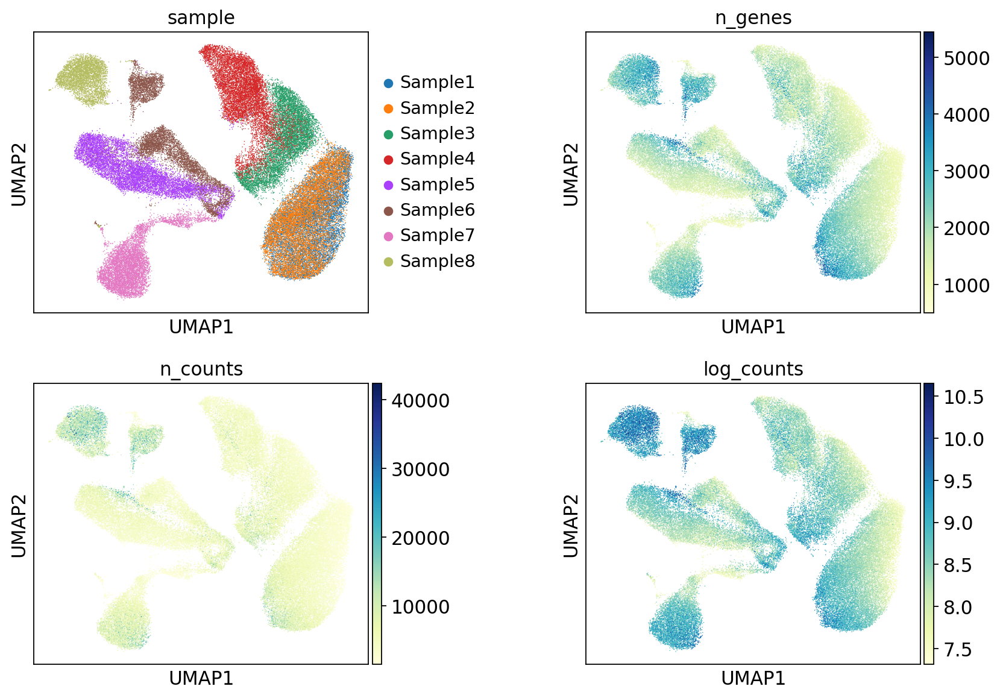

In [14]:
sc.pl.umap(adata, color=['sample', 'n_genes', 'n_counts', 'log_counts'],
           wspace=0.5, ncols=2)

# Highly variable gene selection

In [68]:
#sc.pp.highly_variable_genes(adata, min_mean=0.0125, max_mean=2, min_disp=0.45)
#sc.pl.highly_variable_genes(adata)


In [15]:
adata.raw = adata

In [69]:
#adata.write('tmp_processing_correct.h5ad')

In [70]:
#adata = sc.read('tmp_processing_correct.h5ad')
#adata

# PCs, embedding and visualisation

computing PCA
    with n_comps=50
    finished (0:00:45)


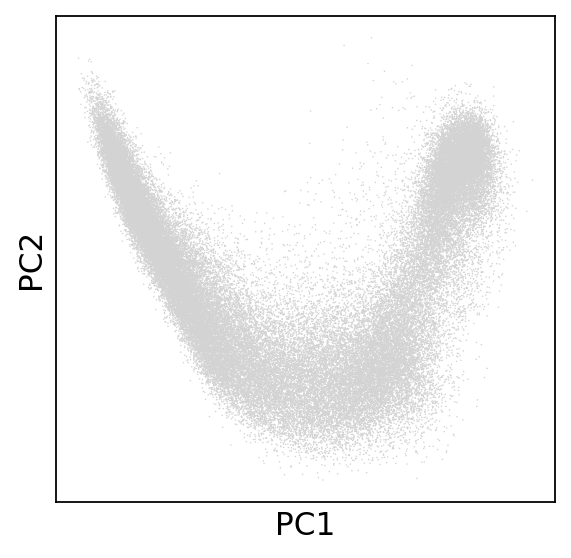

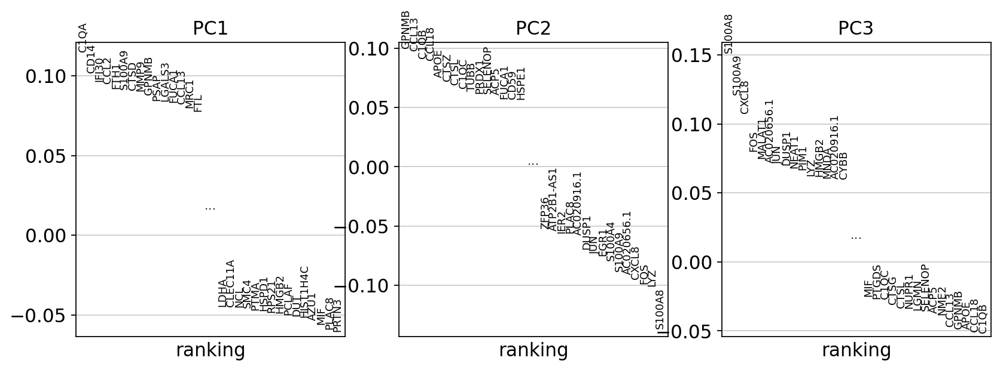

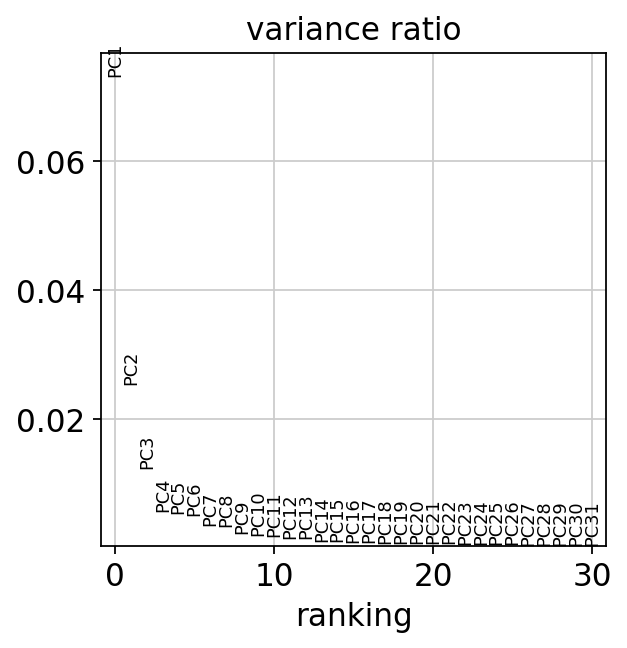

In [16]:
sc.pp.pca(adata)
sc.pl.pca_overview(adata)

In [17]:
sc.pp.neighbors(adata)
sc.tl.umap(adata)
sc.tl.diffmap(adata)

computing neighbors
    using 'X_pca' with n_pcs = 50
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:04)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:25)
computing Diffusion Maps using n_comps=15(=n_dcs)
computing transitions
    finished (0:00:00)
    eigenvalues of transition matrix
    [1.         0.999093   0.99693984 0.99671996 0.9953179  0.9920509
     0.9894318  0.9872497  0.98337626 0.9825315  0.98194915 0.9806831
     0.97656685 0.9747893  0.9720572 ]
    finished: added
    'X_diffmap', diffmap coordinates (adata.obsm)
    'diffmap_evals', eigenvalues of transition matrix (adata.uns) (0:00:03)


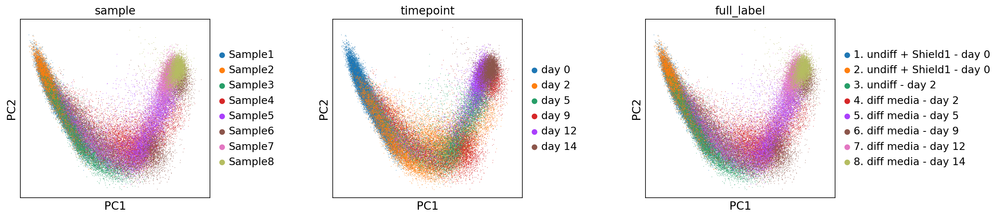

[<Axes: title={'center': 'sample'}, xlabel='PC1', ylabel='PC2'>,
 <Axes: title={'center': 'timepoint'}, xlabel='PC1', ylabel='PC2'>,
 <Axes: title={'center': 'full_label'}, xlabel='PC1', ylabel='PC2'>]

In [18]:
sc.pl.pca(adata, color=['sample', 'timepoint', 'full_label'], wspace=0.5, save='_all_samples.pdf')
sc.pl.pca(adata, color=['sample', 'timepoint', 'full_label'], wspace=0.5, save='_all_samples.png', show=False)
sc.pl.pca(adata, color=['sample', 'timepoint', 'full_label'], wspace=0.5, save='_all_samples.svg', show=False)

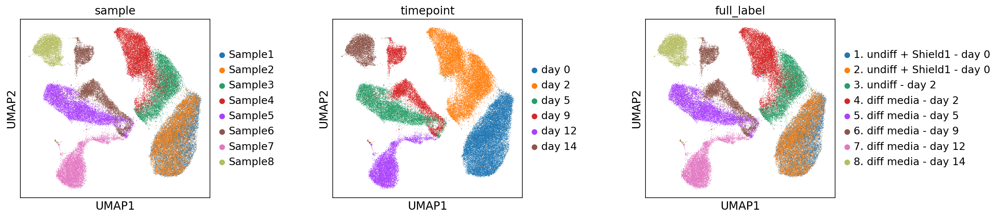

[<Axes: title={'center': 'sample'}, xlabel='UMAP1', ylabel='UMAP2'>,
 <Axes: title={'center': 'timepoint'}, xlabel='UMAP1', ylabel='UMAP2'>,
 <Axes: title={'center': 'full_label'}, xlabel='UMAP1', ylabel='UMAP2'>]

In [19]:
sc.pl.umap(adata, color=['sample', 'timepoint', 'full_label'], wspace=0.5, save='_all_samples.pdf')
sc.pl.umap(adata, color=['sample', 'timepoint', 'full_label'], wspace=0.5, save='_all_samples.png', show=False)
sc.pl.umap(adata, color=['sample', 'timepoint', 'full_label'], wspace=0.5, save='_all_samples.svg', show=False)

In [20]:
adata

AnnData object with n_obs × n_vars = 65587 × 36601
    obs: 'sample', 'cell_barcode_sample', 'full_label', 'timepoint', 'doublet_score', 'predicted_doublet', 'n_counts', 'log_counts', 'n_genes', 'cellranger_n_counts', 'mt_frac', 'n_genes_by_counts', 'total_counts'
    var: 'Accession', 'Chromosome', 'End', 'Start', 'Strand', 'n_cells', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts'
    uns: 'sample_colors', 'scrublet', 'log1p', 'pca', 'neighbors', 'umap', 'diffmap_evals', 'timepoint_colors', 'full_label_colors'
    obsm: 'X_pca', 'X_umap', 'X_diffmap'
    varm: 'PCs'
    layers: 'ambiguous', 'cellranger_count', 'matrix', 'spliced', 'unspliced', 'velocyto_all_count', 'raw_counts'
    obsp: 'distances', 'connectivities'

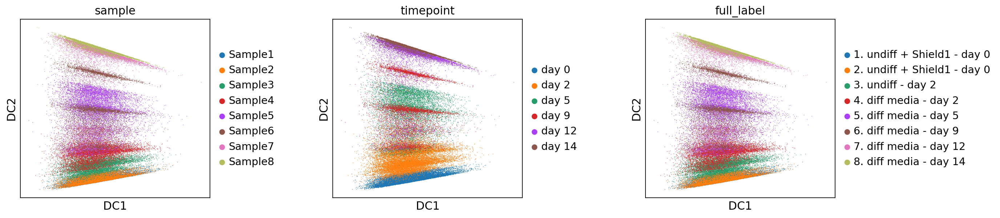

In [21]:
sc.pl.diffmap(adata, color=['sample', 'timepoint', 'full_label'],
              wspace=0.5)

extracting highly variable genes
    finished (0:00:01)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)


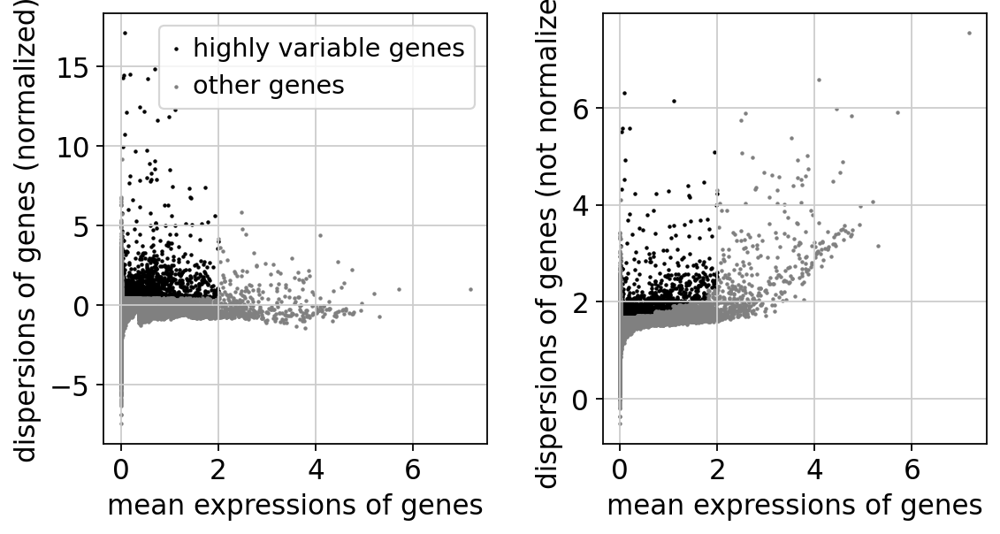

In [22]:
sc.pp.highly_variable_genes(adata, min_mean=0.0125, max_mean=2, min_disp=0.45)
sc.pl.highly_variable_genes(adata)

In [23]:
sc.pp.pca(adata)
sc.pp.neighbors(adata)
#sc.tl.umap(adata)
sc.tl.diffmap(adata)

computing PCA
    on highly variable genes
    with n_comps=50
    finished (0:00:10)
computing neighbors
    using 'X_pca' with n_pcs = 50
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:04)
computing Diffusion Maps using n_comps=15(=n_dcs)
computing transitions
    finished (0:00:00)
    eigenvalues of transition matrix
    [1.         0.9980706  0.9932356  0.9893913  0.9848285  0.97843707
     0.9748121  0.9710127  0.9684638  0.96236354 0.9601446  0.9564516
     0.955017   0.95299774 0.94957757]
    finished: added
    'X_diffmap', diffmap coordinates (adata.obsm)
    'diffmap_evals', eigenvalues of transition matrix (adata.uns) (0:00:02)


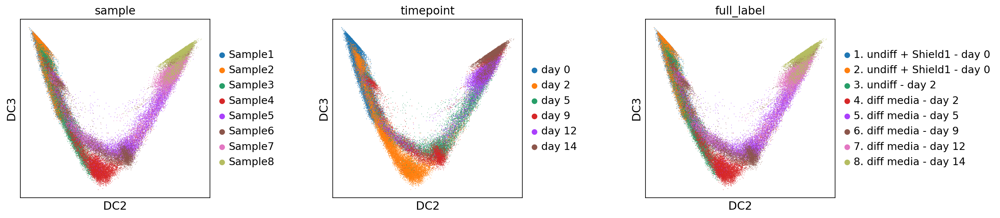

[<Axes: title={'center': 'sample'}, xlabel='DC2', ylabel='DC3'>,
 <Axes: title={'center': 'timepoint'}, xlabel='DC2', ylabel='DC3'>,
 <Axes: title={'center': 'full_label'}, xlabel='DC2', ylabel='DC3'>]

In [27]:
sc.pl.diffmap(adata, color=['sample', 'timepoint', 'full_label'],
              wspace=0.5, dimensions=(1,2),  save='_all_samples.pdf')
sc.pl.diffmap(adata, color=['sample', 'timepoint', 'full_label'],
              wspace=0.5, dimensions=(1,2),  save='_all_samples.png', show=False)
sc.pl.diffmap(adata, color=['sample', 'timepoint', 'full_label'],
              wspace=0.5, dimensions=(1,2),  save='_all_samples.svg', show=False)

In [25]:
adata = adata[:, adata.var.highly_variable]
adata

View of AnnData object with n_obs × n_vars = 65587 × 1880
    obs: 'sample', 'cell_barcode_sample', 'full_label', 'timepoint', 'doublet_score', 'predicted_doublet', 'n_counts', 'log_counts', 'n_genes', 'cellranger_n_counts', 'mt_frac', 'n_genes_by_counts', 'total_counts'
    var: 'Accession', 'Chromosome', 'End', 'Start', 'Strand', 'n_cells', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'highly_variable', 'means', 'dispersions', 'dispersions_norm'
    uns: 'sample_colors', 'scrublet', 'log1p', 'pca', 'neighbors', 'umap', 'diffmap_evals', 'timepoint_colors', 'full_label_colors', 'hvg'
    obsm: 'X_pca', 'X_umap', 'X_diffmap'
    varm: 'PCs'
    layers: 'ambiguous', 'cellranger_count', 'matrix', 'spliced', 'unspliced', 'velocyto_all_count', 'raw_counts'
    obsp: 'distances', 'connectivities'

# Cell cycle analysis

In [26]:
adata.write('tmp_file3.h5ad')

In [28]:
cc_genes_file = './Macosko_cell_cycle_genes.txt'
#Score cell cycle and visualize the effect:
cc_genes = pd.read_table(cc_genes_file, delimiter='\t')
s_genes = cc_genes['S'].dropna()
g2m_genes = cc_genes['G2.M'].dropna()

sc.tl.score_genes_cell_cycle(adata, s_genes=s_genes, g2m_genes=g2m_genes, use_raw=False)

calculating cell cycle phase
computing score 'S_score'
    finished: added
    'S_score', score of gene set (adata.obs).
    911 total control genes are used. (0:00:05)
computing score 'G2M_score'
    finished: added
    'G2M_score', score of gene set (adata.obs).
    899 total control genes are used. (0:00:00)
-->     'phase', cell cycle phase (adata.obs)


... storing 'phase' as categorical


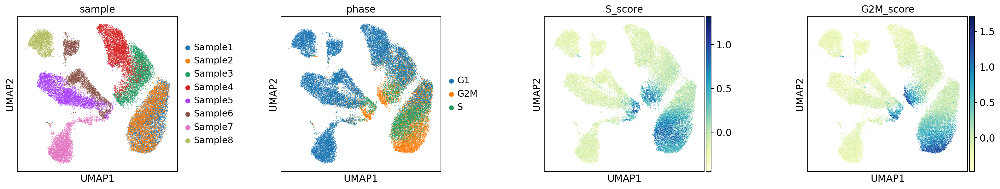

In [29]:

sc.pl.umap(adata, color=['sample', 'phase', 'S_score', 'G2M_score'], wspace=0.5, save="_cell_cycle.pdf")

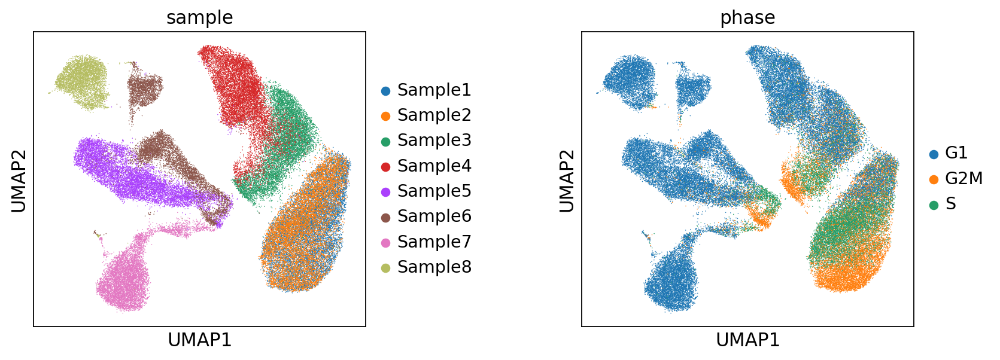

In [30]:
sc.pl.umap(adata, color=['sample','phase'], wspace=0.5)

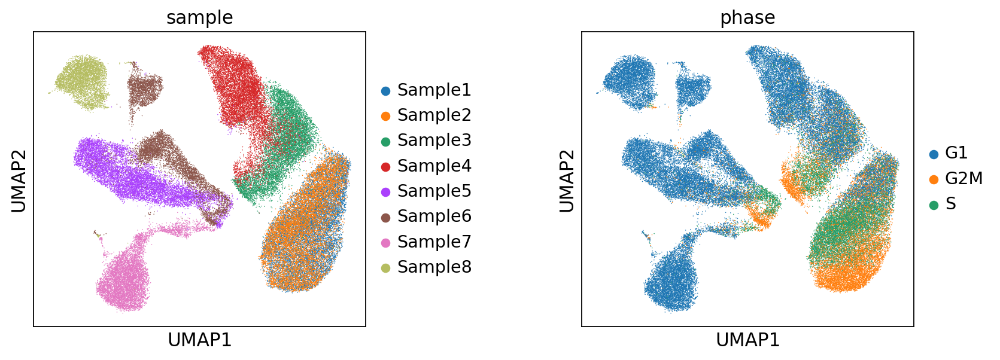

[<Axes: title={'center': 'sample'}, xlabel='UMAP1', ylabel='UMAP2'>,
 <Axes: title={'center': 'phase'}, xlabel='UMAP1', ylabel='UMAP2'>]

In [31]:
sc.pl.umap(adata, color=['sample','phase'], wspace=0.5, save="_cell_cycle_1.pdf")
sc.pl.umap(adata, color=['sample','phase'], wspace=0.5, save="_cell_cycle_1.png", show=False)
sc.pl.umap(adata, color=['sample','phase'], wspace=0.5, save="_cell_cycle_1.pdf", show=False)

phase,G1,G2M,S
sample,,,
Sample1,1347,5141,4471
Sample2,1235,3825,3782
Sample3,4268,2503,2105
Sample4,7463,858,818
Sample5,7980,709,632
Sample6,5466,640,563
Sample7,6787,191,260
Sample8,4476,36,31


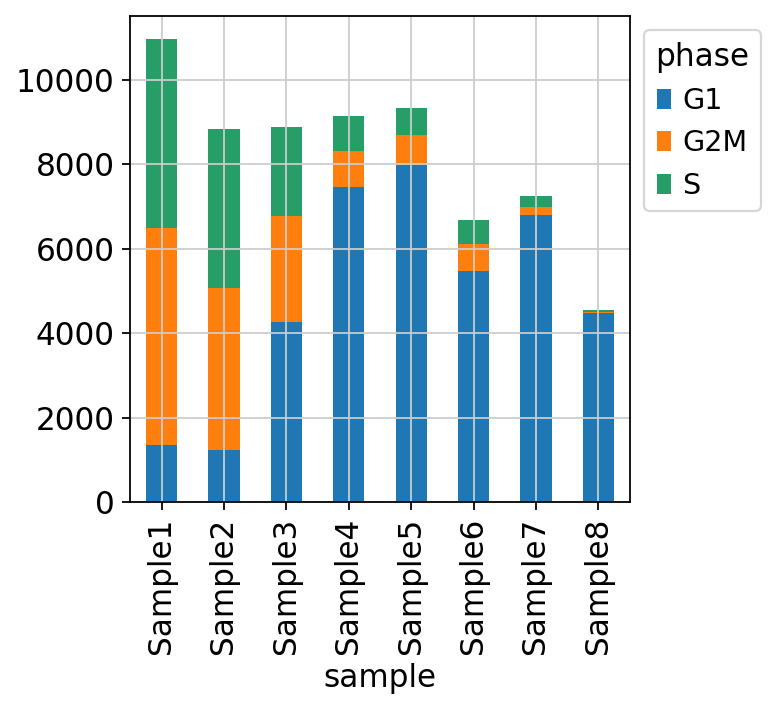

In [32]:

df = pd.crosstab(adata.obs['sample'], adata.obs['phase'])
ax = df.plot(kind='bar', stacked=True, color=adata.uns['phase_colors'])
sns.move_legend(ax, "upper left", bbox_to_anchor=(1, 1))
plt.savefig('nb_cell_compo_cell_cycle.png', dpi=800, bbox_inches='tight')
df




phase,G1,G2M,S
sample,,,
Sample1,12.291267,46.911215,40.797518
Sample2,13.967428,43.259444,42.773128
Sample3,48.084723,28.199639,23.715638
Sample4,81.661013,9.388336,8.950651
Sample5,85.613132,7.606480,6.780388
Sample6,81.961314,9.596641,8.442045
Sample7,93.768997,2.638851,3.592153
Sample8,98.525204,0.792428,0.682368


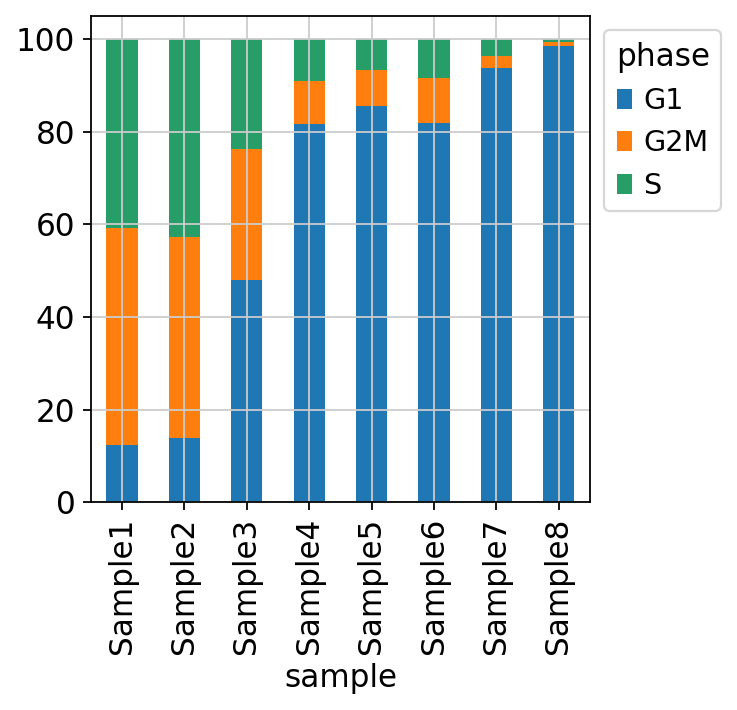

In [33]:
df = pd.crosstab(adata.obs['sample'], adata.obs['phase'])
for i in range(0, len(set(adata.obs['sample']))):
    df.iloc[i] = [x*100/sum(df.iloc[i].tolist()) for x in df.iloc[i].tolist()]
ax = df.plot(kind='bar', stacked=True, color=adata.uns['phase_colors'])
sns.move_legend(ax, "upper left", bbox_to_anchor=(1, 1))
plt.savefig('pct_cell_compo_cell_cycle.png', dpi=800, bbox_inches='tight')
df

In [34]:
adata.write('processed_data_with_cell_cycle.h5ad')

# Cell type annotations

running Leiden clustering
    finished: found 15 clusters and added
    'leiden_celltype', the cluster labels (adata.obs, categorical) (0:00:10)


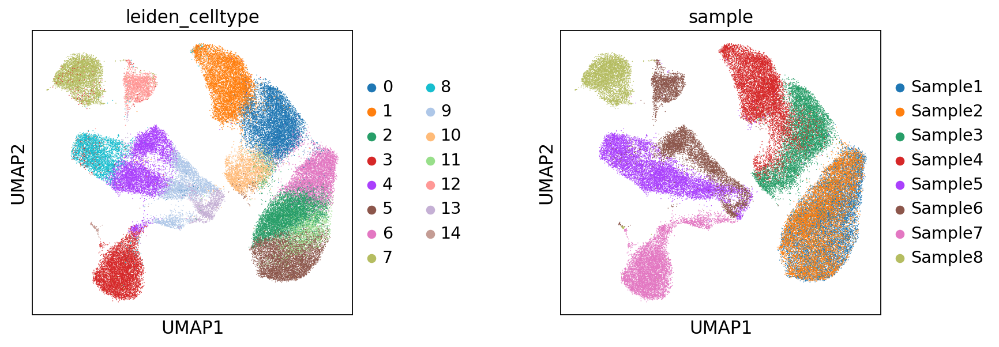

In [35]:
#models.download_models(force_update = True)
#models.models_description()
sc.tl.leiden(adata, resolution=1, key_added='leiden_celltype')
sc.pl.umap(adata, color=['leiden_celltype', 'sample'], wspace=0.5)

In [36]:
adata

AnnData object with n_obs × n_vars = 65587 × 1880
    obs: 'sample', 'cell_barcode_sample', 'full_label', 'timepoint', 'doublet_score', 'predicted_doublet', 'n_counts', 'log_counts', 'n_genes', 'cellranger_n_counts', 'mt_frac', 'n_genes_by_counts', 'total_counts', 'S_score', 'G2M_score', 'phase', 'leiden_celltype'
    var: 'Accession', 'Chromosome', 'End', 'Start', 'Strand', 'n_cells', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'highly_variable', 'means', 'dispersions', 'dispersions_norm'
    uns: 'sample_colors', 'scrublet', 'log1p', 'pca', 'neighbors', 'umap', 'diffmap_evals', 'timepoint_colors', 'full_label_colors', 'hvg', 'phase_colors', 'leiden', 'leiden_celltype_colors'
    obsm: 'X_pca', 'X_umap', 'X_diffmap'
    varm: 'PCs'
    layers: 'ambiguous', 'cellranger_count', 'matrix', 'spliced', 'unspliced', 'velocyto_all_count', 'raw_counts'
    obsp: 'distances', 'connectivities'

⚠️ Warning: invalid expression matrix, expect all genes and log1p normalized expression to 10000 counts per cell. The prediction result may not be accurate
🔬 Input data has 65587 cells and 1880 genes
🔗 Matching reference genes in the model
🧬 1092 features used for prediction
⚖️ Scaling input data
🖋️ Predicting labels
✅ Prediction done!
🗳️ Majority voting the predictions
✅ Majority voting done!


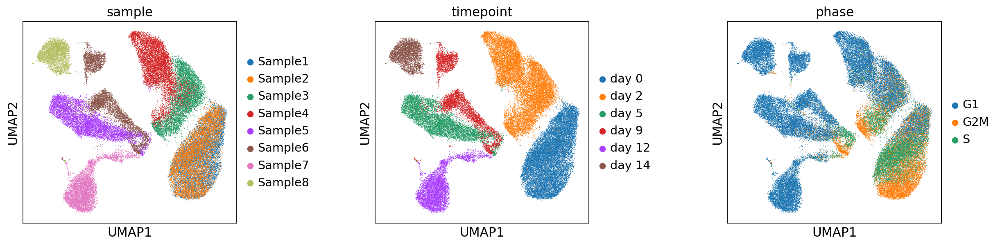

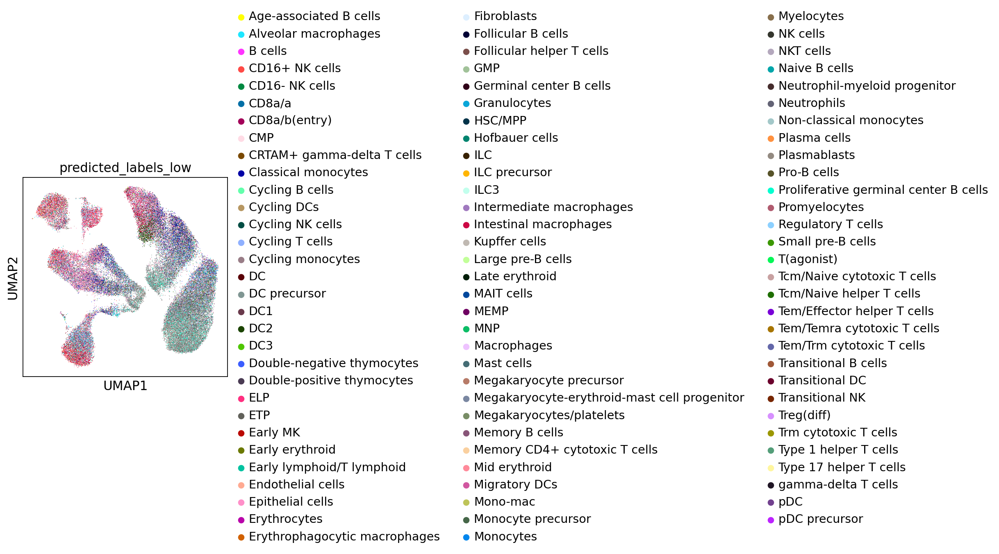

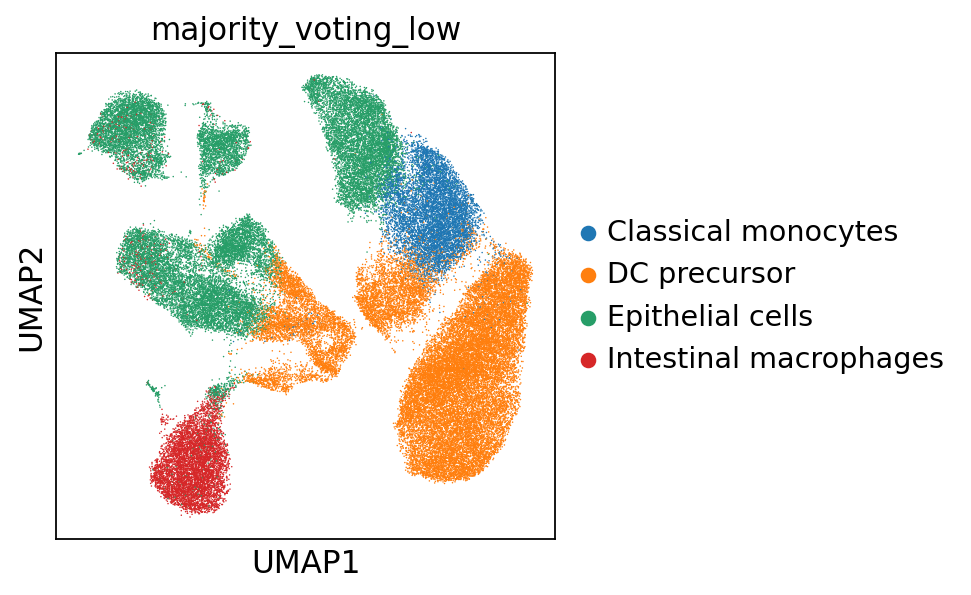

In [38]:
model = models.Model.load(model = 'Immune_All_Low.pkl')
#model.cell_types
predictions = celltypist.annotate(adata, model = 'Immune_All_Low.pkl', majority_voting = True, over_clustering='leiden_celltype')
# Get an `AnnData` with predicted labels embedded into the cell metadata columns.
adata = predictions.to_adata()

adata.obs['majority_voting_low'] = adata.obs['majority_voting']
adata.obs['predicted_labels_low'] = adata.obs['predicted_labels']
sc.pl.umap(adata, color=['sample', 'timepoint', 'phase'], wspace=0.5, ncols=3)
sc.pl.umap(adata, color=['predicted_labels_low'], wspace=0.5, ncols=3, save="predicted_label_label_low.pdf")
sc.pl.umap(adata, color=['majority_voting_low'], wspace=0.5, ncols=3, save="majority_loving_label_low.pdf")

⚠️ Warning: invalid expression matrix, expect all genes and log1p normalized expression to 10000 counts per cell. The prediction result may not be accurate
🔬 Input data has 65587 cells and 1880 genes
🔗 Matching reference genes in the model
🧬 1092 features used for prediction
⚖️ Scaling input data
🖋️ Predicting labels
✅ Prediction done!
🗳️ Majority voting the predictions
✅ Majority voting done!


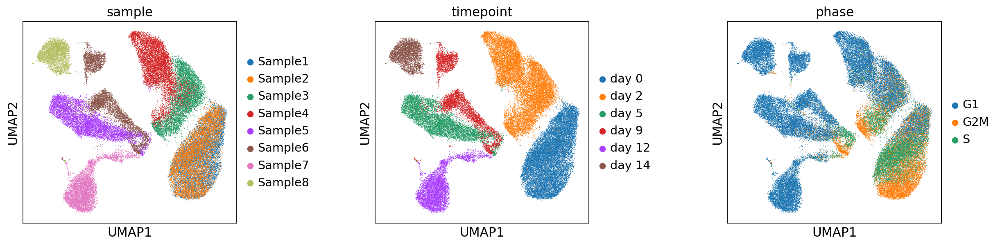

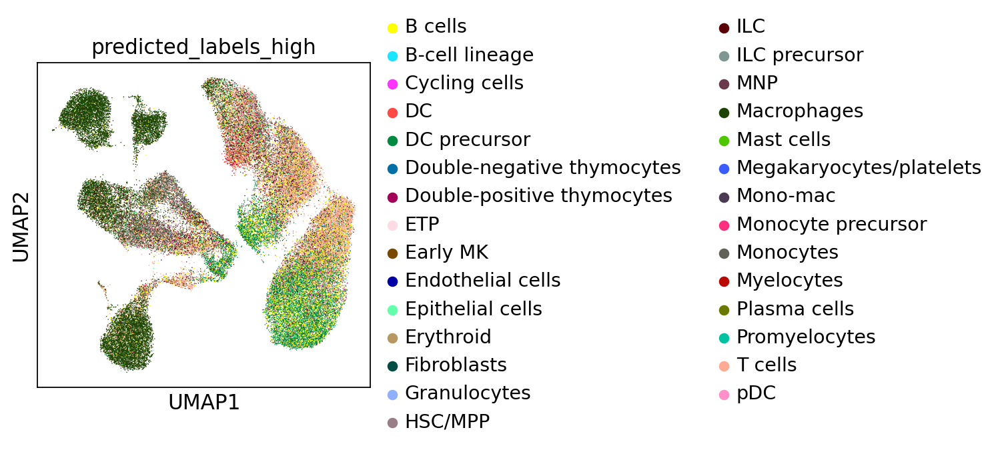

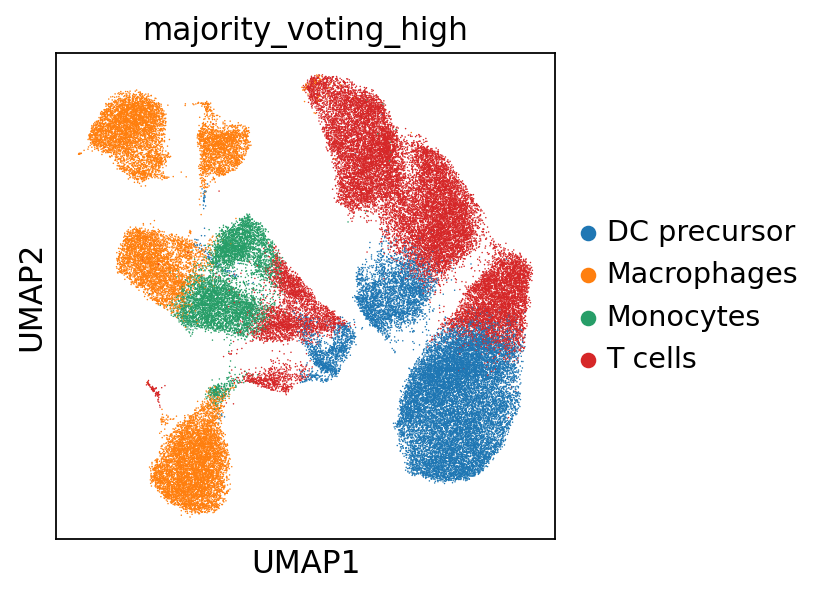

In [40]:
model = models.Model.load(model = 'Immune_All_High.pkl')
#model.cell_types
predictions = celltypist.annotate(adata, model = 'Immune_All_High.pkl', majority_voting = True, over_clustering='leiden_celltype')
# Get an `AnnData` with predicted labels embedded into the cell metadata columns.
adata = predictions.to_adata()

adata.obs['majority_voting_high'] = adata.obs['majority_voting']
adata.obs['predicted_labels_high'] = adata.obs['predicted_labels']
sc.pl.umap(adata, color=['sample', 'timepoint', 'phase'], wspace=0.5, ncols=3)
sc.pl.umap(adata, color=['predicted_labels_high'], wspace=0.5, ncols=3, save="predicted_label_high.pdf")
sc.pl.umap(adata, color=['majority_voting_high'], wspace=0.5, ncols=3, save="majority_loving_label_high.pdf")

### key markers

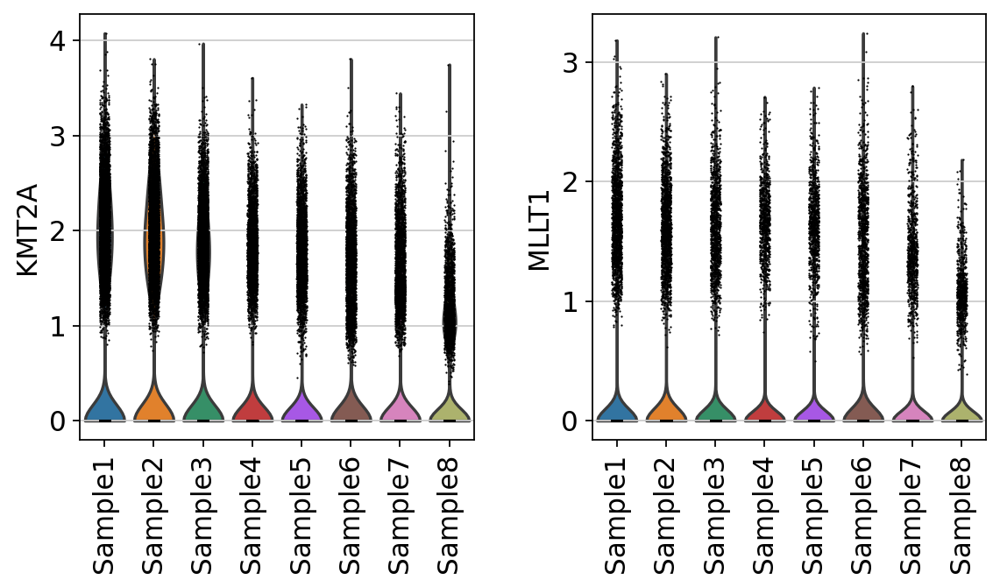

In [99]:
sc.pl.violin(adata, keys=['KMT2A', 'MLLT1'], groupby='sample', rotation=90)

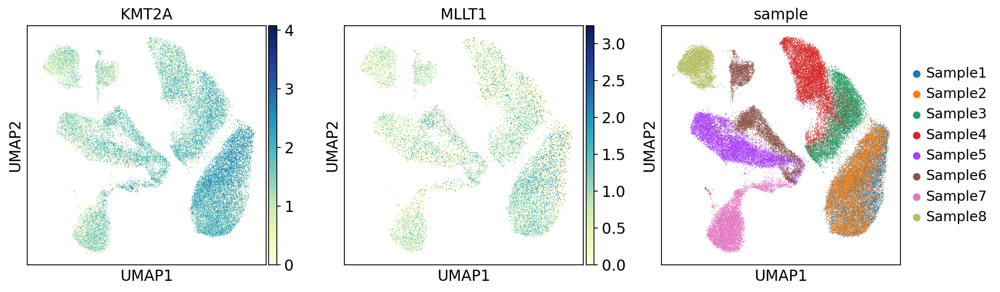

In [100]:
sc.pl.umap(adata, color=['KMT2A', 'MLLT1', 'sample'])

# Diffusion pseudotime

In [59]:
adata.uns['iroot'] = np.flatnonzero(adata.obs['sample']  == 'Sample1')[0]

In [60]:
sc.tl.dpt(adata)

computing Diffusion Pseudotime using n_dcs=10
    finished: added
    'dpt_pseudotime', the pseudotime (adata.obs) (0:00:00)


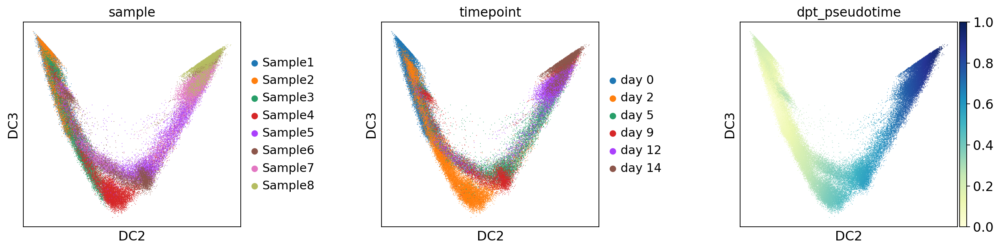

In [61]:

sc.pl.diffmap(adata, color=['sample', 'timepoint', 'dpt_pseudotime'], wspace=0.5, dimensions=(1,2), save="_dpt.pdf")

In [104]:
MLL_AML_markers = ['Adcy9', 'Apoc2', 'Apoc4', 'BC028528', 'Bmi1', 'Bre', 'Cacna2d4', 'Cadm1', 'Camk1', 'Cd4',
                   'Cd70', 'Cd74', 'Ces1g', 'Chchd10', 'Chd3', 'Col9a2', 'Cpm', 'Cpne8', 'Dach1', 'Ereg', 'Fbp1',
                   'Fcgr1', 'Fez1', 'Foxc1', 'Gpm6b', 'Hnmt', 'Hoxa10', 'Hoxa11', 'Hoxa3', 'Hoxa4', 'Hoxa5',
                   'Hoxa7', 'Hoxa9', 'Hspb1', 'Itgax', 'Lamp5', 'Lat2', 'Lcat', 'Meis1', 'Mettl7b', 'Nid1',
                   'Nipa1', 'Parvg', 'Pbx3', 'Pcdh9', 'Pqlc2', 'Pycard', 'Rab27b', 'Rbks', 'Reep3', 'Rnase6',
                   'Rpp25', 'Samhd1', 'Sdc2', 'Sel1l3', 'Skida1', 'Smyd3', 'Socs2', 'Spint1', 'Syt17', 'Trpm4',
                   'Ubxn11', 'Zfp503', 'Zfp521']

macrophage_markers =['MT1G', 'ADAMDEC1', 'CD14', 'MT1A', 'MMP9', 'MT1F', 'TPT1', 'FTL', 'EEF1A1', 'MT1H',
                     'FTHL7', 'TMSB4X', 'IL8', 'HLA-A', 'LAIR1', 'MT2A', 'CEBPB', 'IMAA', 'ITGB2', 'CXCL16',
                     'GNS', 'SRGN', 'C19orf31', 'MRPS6', 'CD44', 'NCOA4', 'FARSLB', 'F2R', 'CTSH', 'OAZ1',
                     'UBC', 'LOC91561', 'CCL5', 'ECGF1', 'LOC388720', 'SAT1', 'LYZ', 'HLA-DRA', 'RPS27',
                     'RPS29', 'ITIH5', 'LILRB3', 'RPL41', 'CTSB', 'ARHGDIB', 'RPS27A', 'CTSL1']


macrophage_markers2 =['MT1G', 'ADAMDEC1', 'CD14', 'MT1A', 'MMP9', 'MT1F', 'TPT1', 'FTL', 'EEF1A1', 'MT1H',
                     'TMSB4X', 'HLA-A', 'LAIR1', 'MT2A', 'CEBPB', 'ITGB2', 'CXCL16',
                     'GNS', 'SRGN', 'MRPS6', 'CD44', 'NCOA4', 'F2R', 'CTSH', 'OAZ1',
                     'UBC', 'CCL5', 'SAT1', 'LYZ', 'HLA-DRA', 'RPS27',
                     'RPS29', 'ITIH5', 'LILRB3', 'RPL41', 'CTSB', 'ARHGDIB', 'RPS27A',]

missing_markers = ['C19orf31', 'CTSL1', 'ECGF1', 'FARSLB', 'FTHL7', 'IL8', 'IMAA', 'LOC388720', 'LOC91561']



In [112]:
paths = [('progenitor', [0, 1]),
         ('macrophace', [2, 3, 4, 5])]

adata.obs['distance'] = adata.obs['dpt_pseudotime']
adata.obs['clusters'] = adata.obs['timepoint']  # just a cosmetic change
adata.uns['clusters_colors'] = adata.uns['timepoint_colors']



In [62]:
adata.write('fully_processed_no_velocity.h5ad')

In [121]:
gene_names = macrophage_markers2.copy()

gene_names2 = ['CHST11',
'AC244033.2',
'SLC16A12-AS1',
'AC092375.2',
'AP000907.2',
'GRIP1',
'AC063977.3',
'SMIM21',

'OR2F2',
'AC068051.1',
'BTBD17',
'AL357079.1',
'PAQR4',
'AC079209.2',
'LINC01946',
'WDR86',
'GHSR',
'REX1BD']

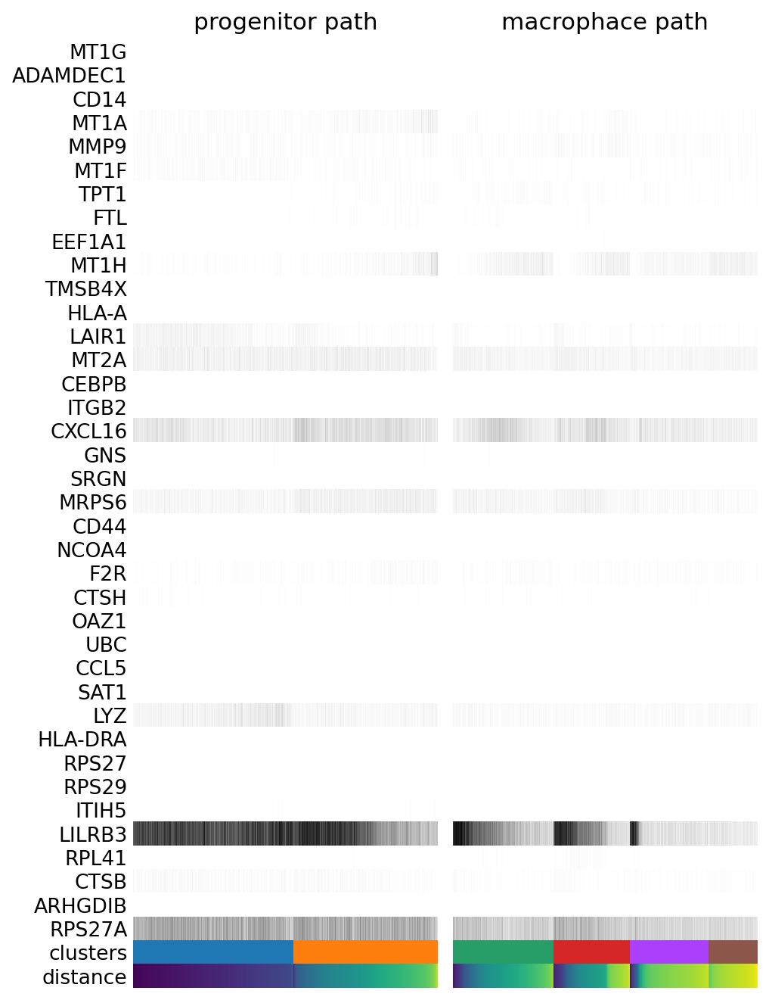

In [120]:
_, axs = plt.subplots(ncols=2, figsize=(6, 12), gridspec_kw={'wspace': 0.05, 'left': 0.12})
plt.subplots_adjust(left=0.05, right=0.98, top=0.82, bottom=0.2)
for ipath, (descr, path) in enumerate(paths):
    _, data = sc.pl.paga_path(
        adata, path, gene_names,
        show_node_names=False,
        ax=axs[ipath],
        ytick_fontsize=12,
        left_margin=0.15,
        n_avg=50,
        annotations=['distance'],
        show_yticks=True if ipath==0 else False,
        show_colorbar=False,
        color_map='Greys',
        groups_key='clusters',
        color_maps_annotations={'distance': 'viridis'},
        title='{} path'.format(descr),
        return_data=True,
        show=False)
    data.to_csv('./paga_path_{}.csv'.format(descr))
plt.savefig('./paga_path_paul15.pdf')
plt.show()



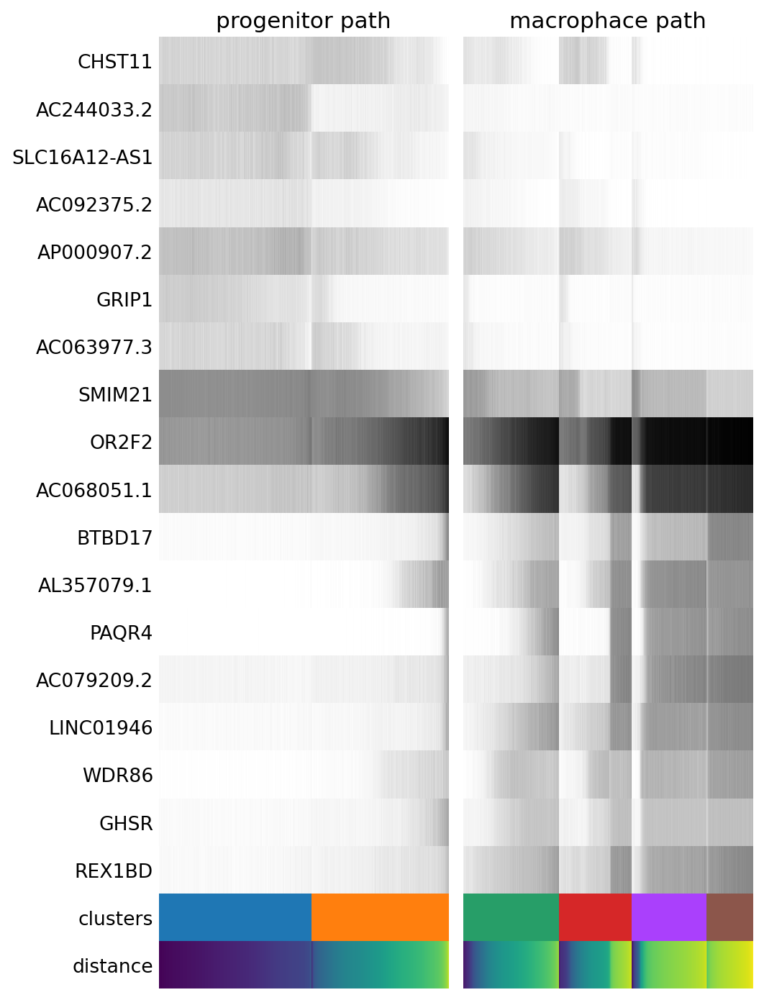

In [122]:
_, axs = plt.subplots(ncols=2, figsize=(6, 12), gridspec_kw={'wspace': 0.05, 'left': 0.12})
plt.subplots_adjust(left=0.05, right=0.98, top=0.82, bottom=0.2)
for ipath, (descr, path) in enumerate(paths):
    _, data = sc.pl.paga_path(
        adata, path, gene_names2,
        show_node_names=False,
        ax=axs[ipath],
        ytick_fontsize=12,
        left_margin=0.15,
        n_avg=50,
        annotations=['distance'],
        show_yticks=True if ipath==0 else False,
        show_colorbar=False,
        color_map='Greys',
        groups_key='clusters',
        color_maps_annotations={'distance': 'viridis'},
        title='{} path'.format(descr),
        return_data=True,
        show=False)
    data.to_csv('./paga_path_2{}.csv'.format(descr))
plt.savefig('./paga_path_paul152.pdf')
plt.show()



In [135]:
paths = [('progenitor', [0, 2, 3, 4]),
         ('macrophace', [7, 1, 8, 5, 6, 9, 10])]

adata.obs['distance'] = adata.obs['dpt_pseudotime']
adata.obs['clusters'] = adata.obs['leiden']  # just a cosmetic change
adata.uns['clusters_colors'] = adata.uns['leiden_colors']



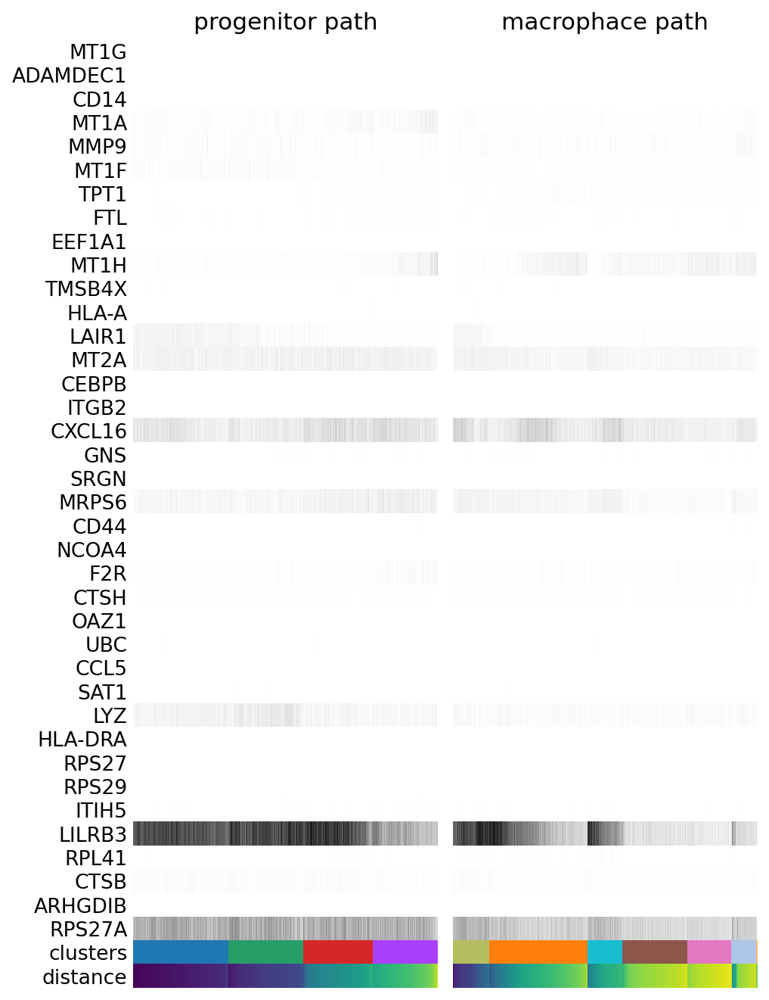

In [136]:
_, axs = plt.subplots(ncols=2, figsize=(6, 12), gridspec_kw={'wspace': 0.05, 'left': 0.12})
plt.subplots_adjust(left=0.05, right=0.98, top=0.82, bottom=0.2)
for ipath, (descr, path) in enumerate(paths):
    _, data = sc.pl.paga_path(
        adata, path, gene_names,
        show_node_names=False,
        ax=axs[ipath],
        ytick_fontsize=12,
        left_margin=0.15,
        n_avg=50,
        annotations=['distance'],
        show_yticks=True if ipath==0 else False,
        show_colorbar=False,
        color_map='Greys',
        groups_key='clusters',
        color_maps_annotations={'distance': 'viridis'},
        title='{} path'.format(descr),
        return_data=True,
        show=False)
    data.to_csv('./paga_path_3{}.csv'.format(descr))
plt.savefig('./paga_path_paul15_3.pdf')
plt.show()



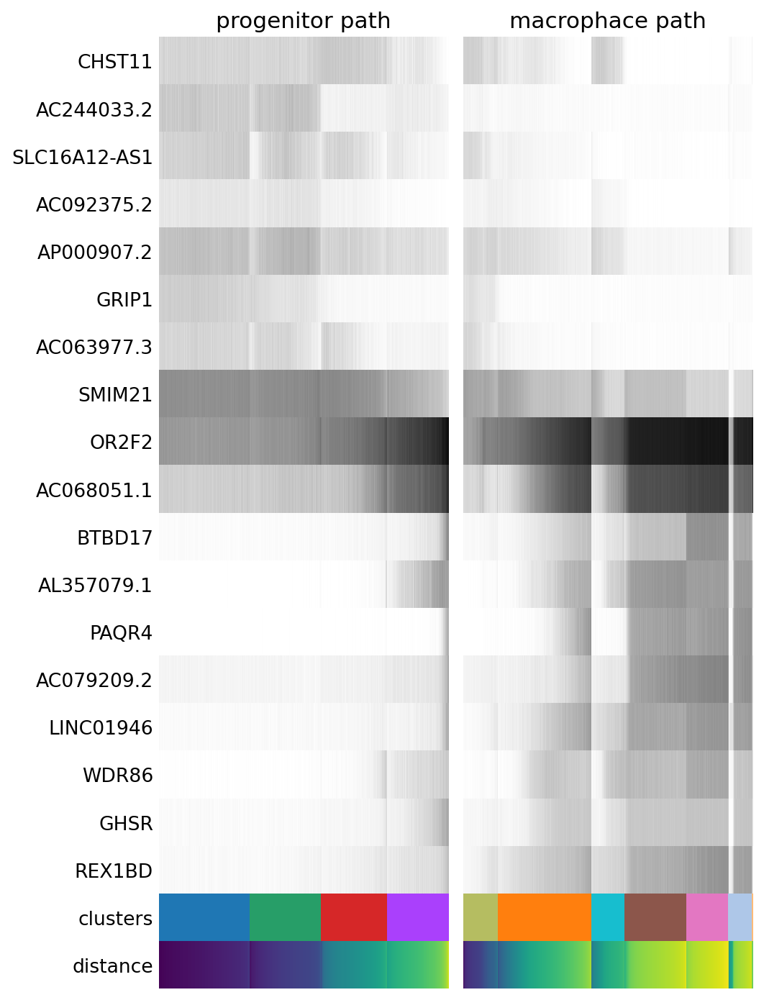

In [137]:
_, axs = plt.subplots(ncols=2, figsize=(6, 12), gridspec_kw={'wspace': 0.05, 'left': 0.12})
plt.subplots_adjust(left=0.05, right=0.98, top=0.82, bottom=0.2)
for ipath, (descr, path) in enumerate(paths):
    _, data = sc.pl.paga_path(
        adata, path, gene_names2,
        show_node_names=False,
        ax=axs[ipath],
        ytick_fontsize=12,
        left_margin=0.15,
        n_avg=50,
        annotations=['distance'],
        show_yticks=True if ipath==0 else False,
        show_colorbar=False,
        color_map='Greys',
        groups_key='clusters',
        color_maps_annotations={'distance': 'viridis'},
        title='{} path'.format(descr),
        return_data=True,
        show=False)
    data.to_csv('./paga_path_4{}.csv'.format(descr))
plt.savefig('./paga_path_paul15_4.pdf')
plt.show()



In [105]:
sc.tl.leiden(adata, resolution=0.3)

running Leiden clustering
    finished: found 8 clusters and added
    'leiden', the cluster labels (adata.obs, categorical) (0:00:06)


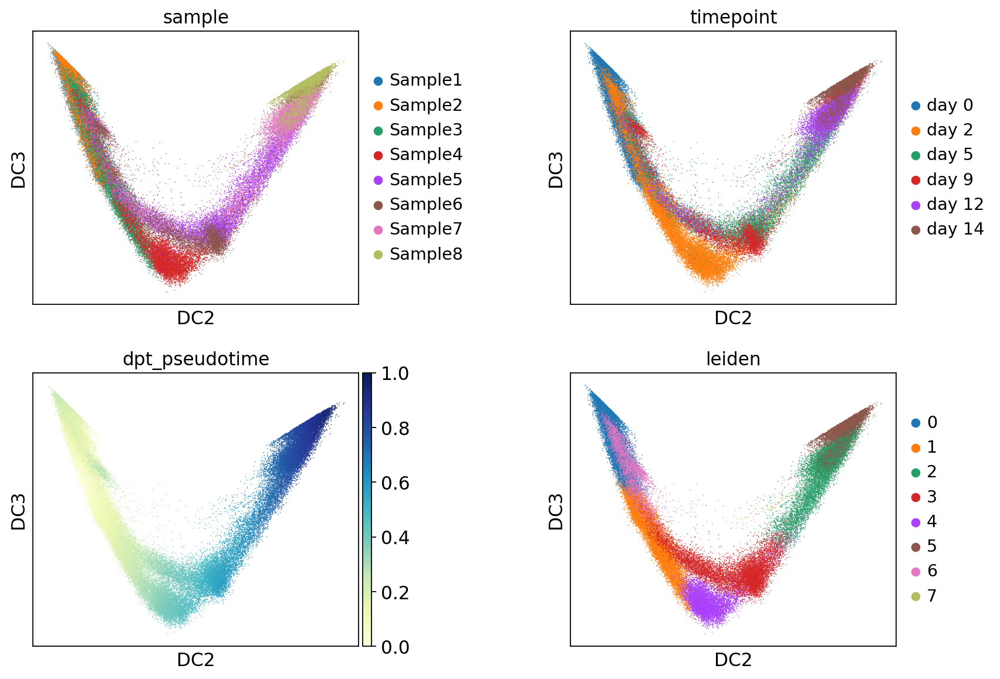

In [106]:

sc.pl.diffmap(adata, color=['sample', 'timepoint',
                            'dpt_pseudotime', 'leiden'],
              ncols=2, wspace=0.5, dimensions=(1,2), save="_dpt.pdf")

# Differential expression

ranking genes
    finished: added to `.uns['rank_genes_groups']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:05)


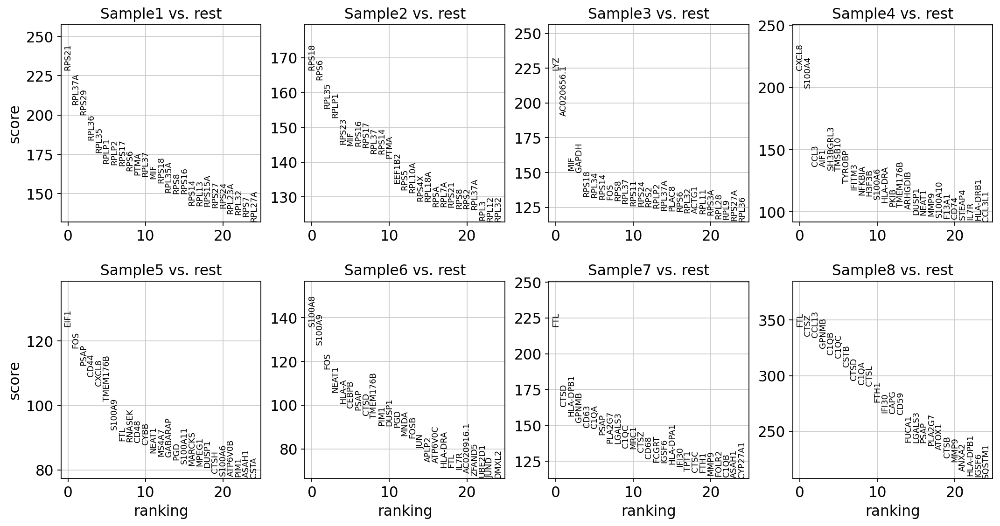

In [44]:
sc.tl.rank_genes_groups(adata, 'sample', method='t-test', use_raw=True)
sc.pl.rank_genes_groups(adata, n_genes=25, sharey=False)



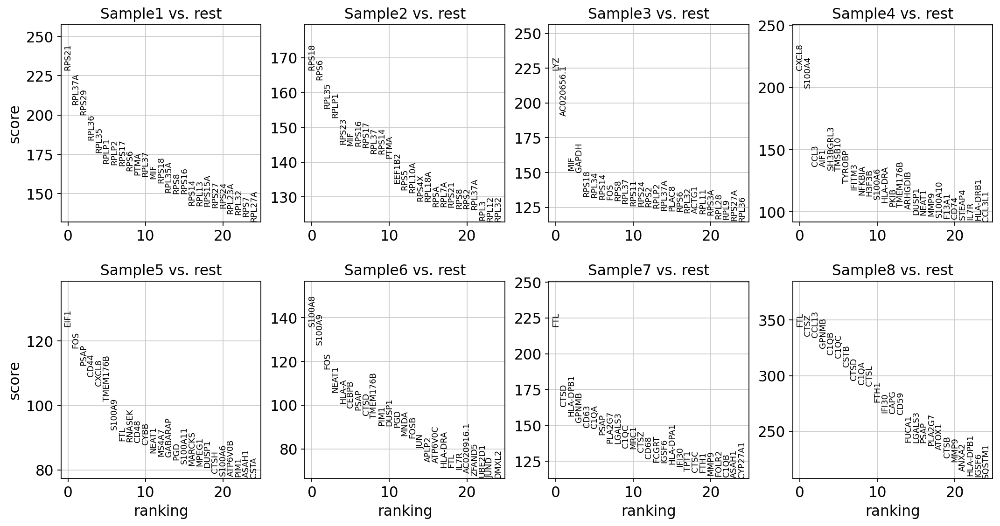

In [48]:
sc.pl.rank_genes_groups(adata, n_genes=25, sharey=False, save='_all_samples.pdf')

    using 'X_pca' with n_pcs = 50
Storing dendrogram info using `.uns['dendrogram_sample']`


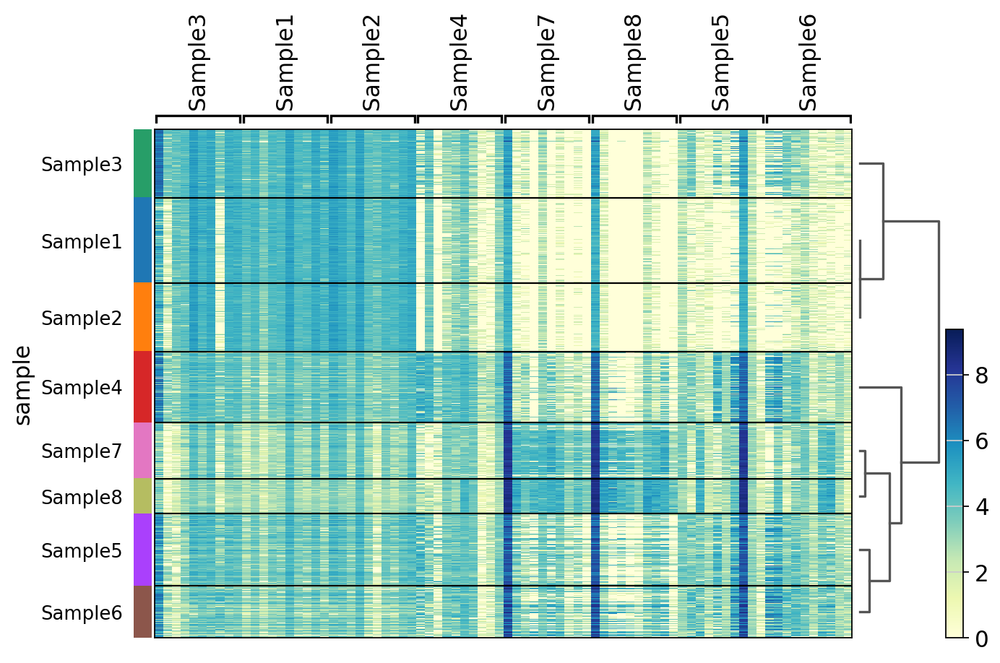

In [45]:
sc.pl.rank_genes_groups_heatmap(adata, save='_all_samples.pdf')

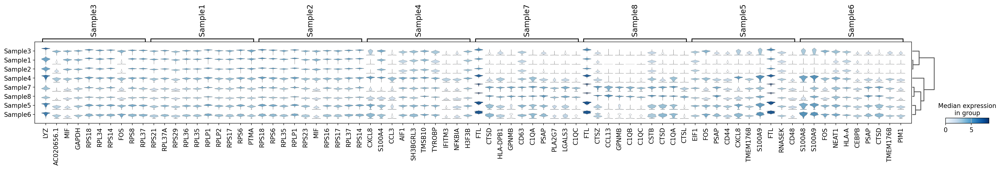

In [46]:
sc.pl.rank_genes_groups_stacked_violin(adata, save='_all_samples.pdf')

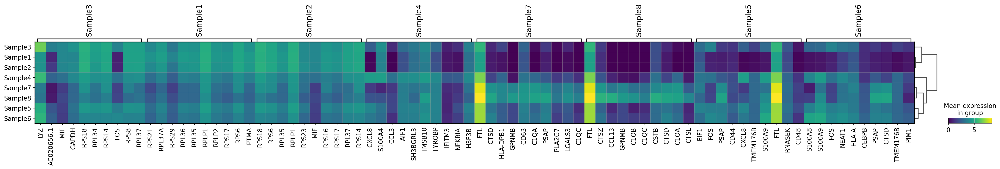

In [47]:
sc.pl.rank_genes_groups_matrixplot(adata, save='_all_samples.pdf')

### Sample 1+2 VS Sample 8 

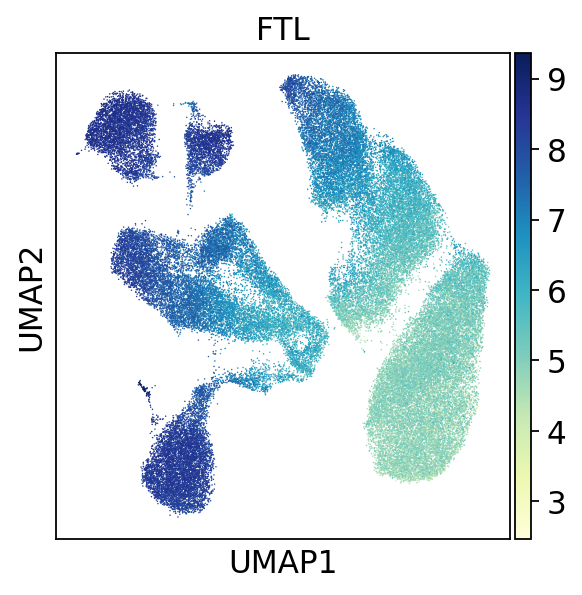

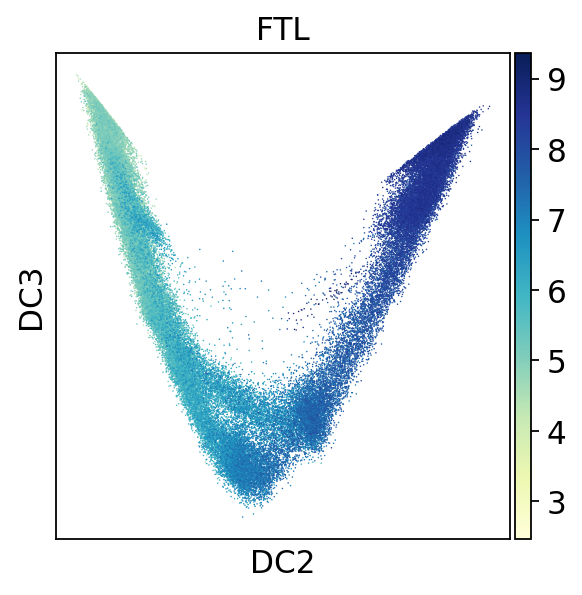

In [112]:
sc.pl.umap(adata, color='FTL')
sc.pl.diffmap(adata, color='FTL', wspace=0.5, dimensions=(1,2))

In [113]:
adata.write('tmp_processed_file2.h5ad')

# Pathway enrichment 
GSEA - Gene Set Enrichment Analysis

In [2]:
adata = sc.read('tmp_processed_file2.h5ad')
adata

AnnData object with n_obs × n_vars = 65587 × 1880
    obs: 'sample', 'cell_barcode_sample', 'full_label', 'timepoint', 'doublet_score', 'predicted_doublet', 'n_counts', 'log_counts', 'n_genes', 'cellranger_n_counts', 'mt_frac', 'n_genes_by_counts', 'total_counts', 'S_score', 'G2M_score', 'phase', 'leiden_celltype', 'predicted_labels', 'over_clustering', 'majority_voting', 'conf_score', 'majority_voting_low', 'predicted_labels_low', 'majority_voting_high', 'predicted_labels_high', 'dpt_pseudotime', 'leiden'
    var: 'Accession', 'Chromosome', 'End', 'Start', 'Strand', 'n_cells', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'highly_variable', 'means', 'dispersions', 'dispersions_norm'
    uns: 'dendrogram_sample', 'diffmap_evals', 'full_label_colors', 'hvg', 'iroot', 'leiden', 'leiden_celltype_colors', 'leiden_colors', 'log1p', 'majority_voting_high_colors', 'majority_voting_low_colors', 'neighbors', 'pca', 'phase_colors', 'predicted_labels_high_colors', '

In [3]:
set(adata.obs['timepoint'])

{'day 0', 'day 12', 'day 14', 'day 2', 'day 5', 'day 9'}

In [4]:
adata2 = adata[adata.obs['timepoint']!='day 2',:].copy()
adata2 = adata2[adata2.obs['timepoint']!='day 5',:].copy()
adata2 = adata2[adata2.obs['timepoint']!='day 9',:].copy()
adata2 = adata2[adata2.obs['timepoint']!='day 12',:].copy()

In [5]:
# get the count matrix of a bunch of interesting cells and interesting genes as a df
#df = pd.DataFrame(adata2.raw.X.todense())
df = pd.DataFrame(adata2.X.todense())
set(adata2.obs["timepoint"])

{'day 0', 'day 14'}

In [6]:
# the thing was probably developed by R-people, idk
df = df.T
#df.index = adata2.raw.var_names.tolist()
df.index = adata2.var_names.tolist()
sample_names = list(adata2.obs["timepoint"])

In [7]:


# fun fact: there won't be a plot even if you set "no_plot" to False
# at least not for me
gs_res = gp2.gsea(data=df, 
                 gene_sets='KEGG_2016', # enrichr library names
                 cls=sample_names, 
                 # set permutation_type to phenotype if samples >=15
                 permutation_type='phenotype',
                 permutation_num=100, # reduce number to speed up test
                 min_size=5,
                 max_size=200,
                 outdir=None,  # do not write output to disk
                 no_plot=True, # Skip plotting
                 method='signal_to_noise',
                 processes=4, seed= 7,
                 format='png')
gs_res.res2d.to_csv("gsea_day_0_day_14_both_timepoint.csv")
gs_res.res2d[0:20]

NameError: name 'gp2' is not defined

In [105]:
# from your gs_res.res2d you pick a term you like (here: number 3) and then plot it
from gseapy.plot import gseaplot, heatmap
terms = gs_res.res2d.index
gseaplot(gs_res.ranking, term=terms[1], **gs_res.results[terms[1]])
plt.savefig("CSF3R_mutant_gsea_chronic_yeloid_leukemia.pdf", bbox_inches="tight")

KeyError: 1

# GProfiler

In [13]:
del adata2.uns['log1p']

In [24]:
### Mutant enrichment at both timepoint
plt.rcParams['figure.figsize']=(10,10) #rescale figures
sc.tl.rank_genes_groups(adata2, groupby='sample', n_genes=400, use_raw=True)
set(adata2.obs['sample'])

# all differential genes from 1st cluster so 'CSF3R T618I'
genes = []
for n in [list(x)[:-1] for x in adata2.uns['rank_genes_groups']['names'].tolist()]:
    genes += n
    
genes

ranking genes
    finished: added to `.uns['rank_genes_groups']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:01)


['FAM92A',
 'AC105290.1',
 'AC139718.2',
 'OOSP4B',
 'AC078909.1',
 'AC129803.1',
 'S100G',
 'ERBB2',
 'AL355112.1',
 'GPR176-DT',
 'AL353612.1',
 'MIR99AHG',
 'LINC02516',
 'CAMKMT',
 'BMP15',
 'AC010973.2',
 'NACAD',
 'AC091057.3',
 'AC008474.1',
 'TTTY19',
 'ADAMTSL4-AS1',
 'TMPRSS3',
 'POLE',
 'SMIM21',
 'BDNF-AS',
 'ADAMTSL4-AS1',
 'AC004584.3',
 'PCDHB6',
 'BTBD7',
 'AP000907.2',
 'SMIM21',
 'AC018861.2',
 'HEXB',
 'ZNF775',
 'CRYBB1',
 'AC013403.2',
 'GMIP',
 'RNF130',
 'LINC00393',
 'CXorf51B',
 'TRIM49',
 'LINC02773',
 'SIAE',
 'LAMTOR1',
 'LRRC17',
 'GPD1',
 'RNF130',
 'LINC00393',
 'LINC02561',
 'SIAE',
 'FAH',
 'AC244033.2',
 'AC013403.2',
 'P4HA3-AS1',
 'AC104806.2',
 'GNGT1',
 'AC073111.4',
 'BTBD7',
 'MTOR',
 'IFNL3',
 'SUSD6',
 'AL513327.2',
 'PRDX3',
 'PNMA6F',
 'ERBB2',
 'TRIM49',
 'AC091057.3',
 'PTPN4',
 'GNGT1',
 'GTF3C6',
 'AC010973.2',
 'SUSD6',
 'SLC4A5',
 'AC073111.4',
 'LINC01231',
 'BDNF-AS',
 'LINC02826',
 'OR13C8',
 'PBOV1',
 'CRYBB1',
 'AC010494.1',
 'FAH'

In [25]:
#Interpretation of differentially expressed genes in paneth cells - g:profiler
gp = GProfiler(return_dataframe=True, user_agent='g:GOSt')

csf3r_enrichment = gp.profile(organism='hsapiens', sources=['GO:BP'], user_threshold=0.05,
                               significance_threshold_method='fdr', 
                               background=adata2.var_names.tolist(), 
                               query=genes)



In [29]:
gp.profile?

In [15]:
#csf3r_enrichment_results = csf3r_enrichment.sort_values('p_value').iloc[:,[2,3,5,6,11]]
csf3r_enrichment_results = csf3r_enrichment.set_index('native').sort_values('p_value').iloc[:,[2,5,7,10,1]]
pd.set_option("display.max_colwidth", 800)
csf3r_enrichment_results.iloc[:50,:]

,p_value,term_size,intersection_size,recall,name
native,,,,,


In [ ]:
plot_enrich(csf3r_enrichment_results, save="GO_enrich_CSF3R_T618I_egfp_positive_cells_all_samples.png")

# PAGA

running PAGA
    finished: added
    'paga/connectivities', connectivities adjacency (adata.uns)
    'paga/connectivities_tree', connectivities subtree (adata.uns) (0:00:00)
--> added 'pos', the PAGA positions (adata.uns['paga'])


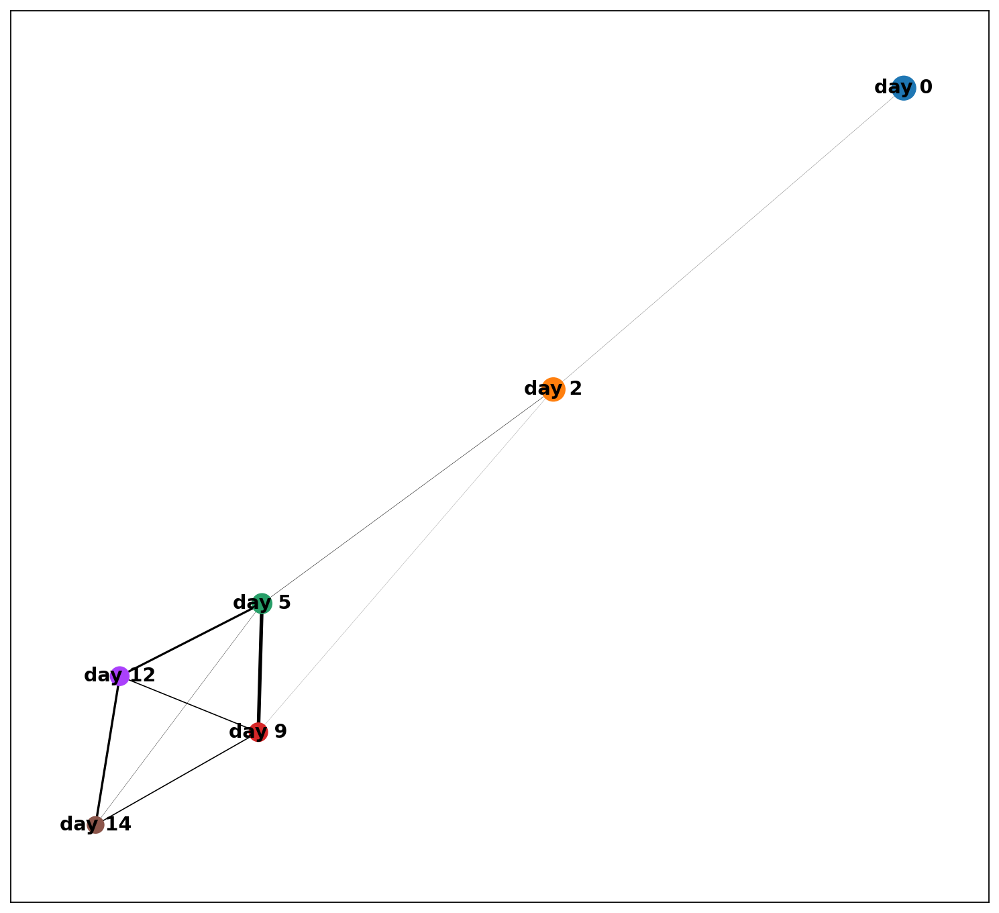

In [23]:
sc.tl.paga(adata, groups='timepoint')
sc.pl.paga(adata)

# Input from Roland -> marker genes

In [38]:
adata

AnnData object with n_obs × n_vars = 67255 × 2851
    obs: 'sample', 'full_label', 'timepoint', 'doublet_score', 'predicted_doublet', 'n_counts', 'log_counts', 'n_genes', 'mt_frac', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'velocity_self_transition', 'S_score', 'G2M_score', 'phase', 'predicted_labels', 'over_clustering', 'majority_voting', 'conf_score'
    var: 'Accession', 'Chromosome', 'End', 'Start', 'Strand', 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'velocity_gamma', 'velocity_qreg_ratio', 'velocity_r2', 'velocity_genes'
    uns: 'diffmap_evals', 'full_label_colors', 'hvg', 'leiden', 'log1p', 'majority_voting_colors', 'neighbors', 'pca', 'phase_colors', 'predicted_labels_colors', 'sample_colors', 'scrublet', 'timepoint_colors', 'umap', 'velocity_graph', 'velocity_graph_neg', 'velocity_params', 'paga', 'timepoint_sizes'
    obsm: 'X_diffmap', 'X_pc

In [37]:
MLL_AML_markers = ['Adcy9', 'Apoc2', 'Apoc4', 'BC028528', 'Bmi1', 'Bre', 'Cacna2d4', 'Cadm1', 'Camk1', 'Cd4',
                   'Cd70', 'Cd74', 'Ces1g', 'Chchd10', 'Chd3', 'Col9a2', 'Cpm', 'Cpne8', 'Dach1', 'Ereg', 'Fbp1',
                   'Fcgr1', 'Fez1', 'Foxc1', 'Gpm6b', 'Hnmt', 'Hoxa10', 'Hoxa11', 'Hoxa3', 'Hoxa4', 'Hoxa5',
                   'Hoxa7', 'Hoxa9', 'Hspb1', 'Itgax', 'Lamp5', 'Lat2', 'Lcat', 'Meis1', 'Mettl7b', 'Nid1',
                   'Nipa1', 'Parvg', 'Pbx3', 'Pcdh9', 'Pqlc2', 'Pycard', 'Rab27b', 'Rbks', 'Reep3', 'Rnase6',
                   'Rpp25', 'Samhd1', 'Sdc2', 'Sel1l3', 'Skida1', 'Smyd3', 'Socs2', 'Spint1', 'Syt17', 'Trpm4',
                   'Ubxn11', 'Zfp503', 'Zfp521']

macrophage_markers =['MT1G', 'ADAMDEC1', 'CD14', 'MT1A', 'MMP9', 'MT1F', 'TPT1', 'FTL', 'EEF1A1', 'MT1H',
                     'FTHL7', 'TMSB4X', 'IL8', 'HLA-A', 'LAIR1', 'MT2A', 'CEBPB', 'IMAA', 'ITGB2', 'CXCL16',
                     'GNS', 'SRGN', 'C19orf31', 'MRPS6', 'CD44', 'NCOA4', 'FARSLB', 'F2R', 'CTSH', 'OAZ1',
                     'UBC', 'LOC91561', 'CCL5', 'ECGF1', 'LOC388720', 'SAT1', 'LYZ', 'HLA-DRA', 'RPS27',
                     'RPS29', 'ITIH5', 'LILRB3', 'RPL41', 'CTSB', 'ARHGDIB', 'RPS27A', 'CTSL1']


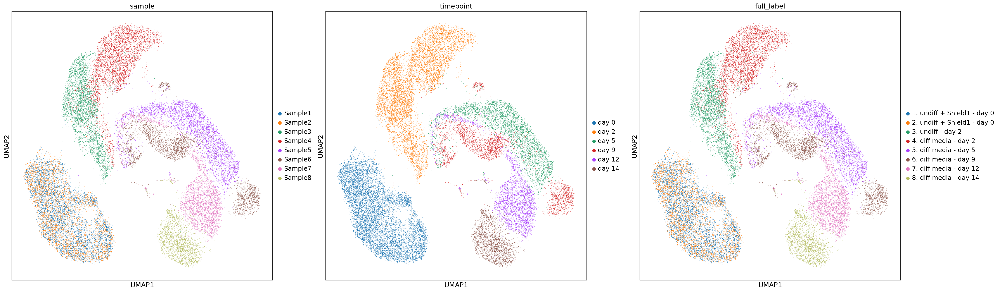

In [39]:
sc.pl.umap(adata, color=['sample', 'timepoint', 'full_label'])

In [45]:
scv.settings.verbosity = 3  # show errors(0), warnings(1), info(2), hints(3)
scv.settings.presenter_view = True  # set max width size for presenter view
scv.set_figure_params('scvelo')  # for beautified visualization



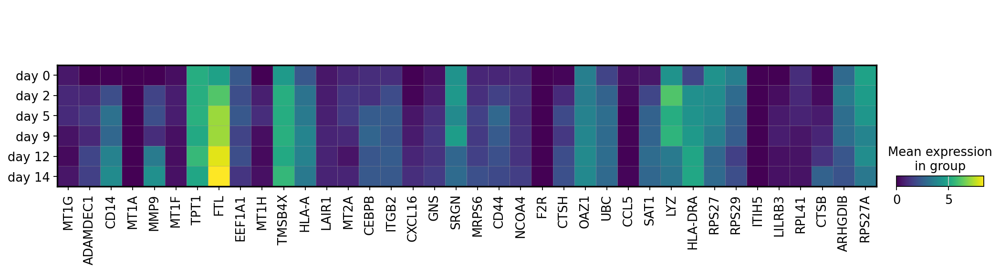

In [120]:
macrophage_markers2 =['MT1G', 'ADAMDEC1', 'CD14', 'MT1A', 'MMP9', 'MT1F', 'TPT1', 'FTL', 'EEF1A1', 'MT1H',
                     'TMSB4X', 'HLA-A', 'LAIR1', 'MT2A', 'CEBPB', 'ITGB2', 'CXCL16',
                     'GNS', 'SRGN', 'MRPS6', 'CD44', 'NCOA4', 'F2R', 'CTSH', 'OAZ1',
                     'UBC', 'CCL5', 'SAT1', 'LYZ', 'HLA-DRA', 'RPS27',
                     'RPS29', 'ITIH5', 'LILRB3', 'RPL41', 'CTSB', 'ARHGDIB', 'RPS27A',]

missing_markers = ['C19orf31', 'CTSL1', 'ECGF1', 'FARSLB', 'FTHL7', 'IL8', 'IMAA', 'LOC388720', 'LOC91561']
sc.pl.matrixplot(adata, var_names=macrophage_markers2, groupby='timepoint')

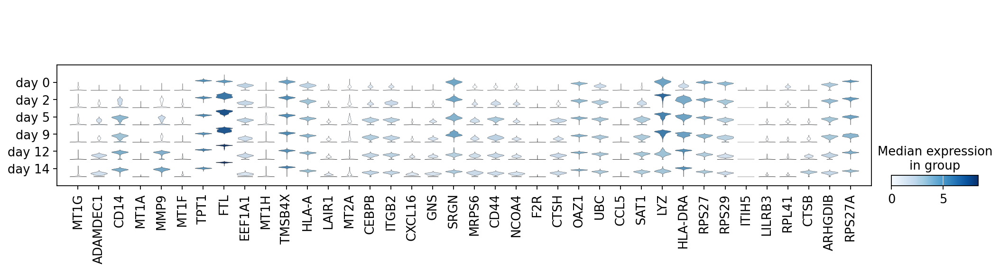

In [121]:
sc.pl.stacked_violin(adata, var_names=macrophage_markers2, groupby='timepoint')

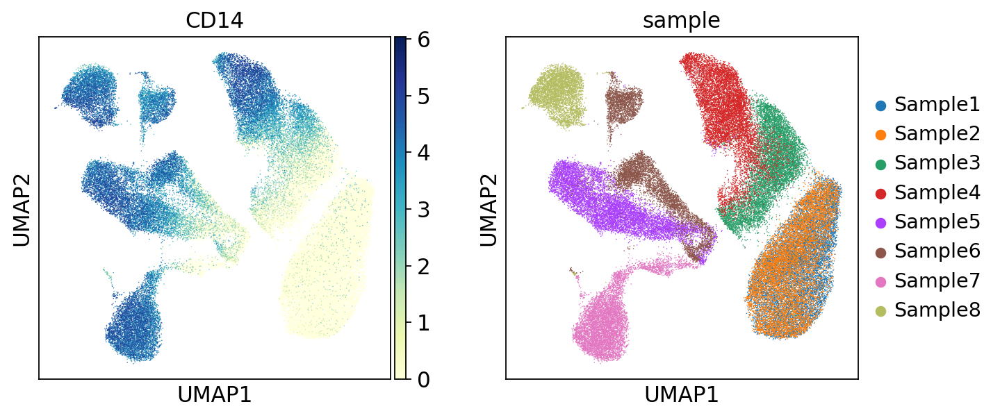

In [123]:
sc.pl.umap(adata, color=['CD14', 'sample'])

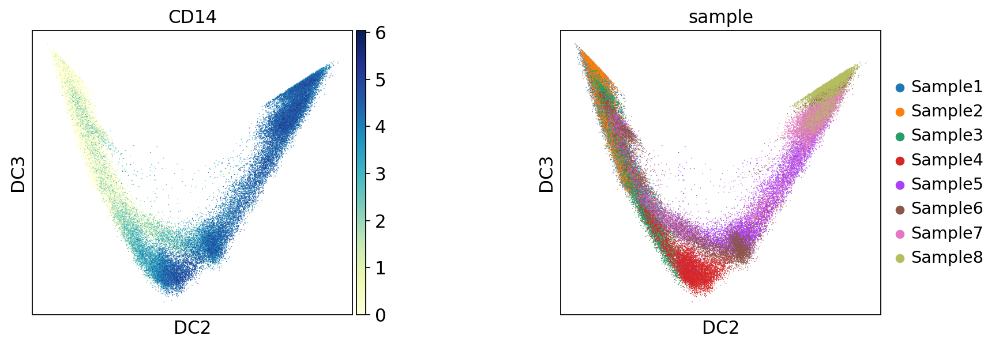

In [43]:
sc.pl.diffmap(adata, color=['CD14', 'sample'],
              wspace=0.5, dimensions=(1,2),  save='_all_samples.svg')

In [168]:
adata.obs

,sample,full_label,timepoint,doublet_score,predicted_doublet,n_counts,log_counts,n_genes,mt_frac,n_genes_by_counts,...,G2M_score,phase,predicted_labels,majority_voting,conf_score,dpt_pseudotime,distance,clusters,leiden,over_clustering
CellID,,,,,,,,,,,,,,,,,,,,,
Sample1:AAAGGTATCGTGCAGCx-0-0-0-0-0-0-0,Sample1,1. undiff + Shield1 - day 0,day 0,0.128107,False,481.265869,8.840291,2954,0.000000,2954,...,-0.005366,G1,Epithelial cells,Early MK,0.758600,0.000000,0.000000,0,0,203
Sample1:AAAGAACGTGTGGACAx-0-0-0-0-0-0-0,Sample1,1. undiff + Shield1 - day 0,day 0,0.034682,False,402.206207,8.662332,2144,0.000000,2144,...,-0.006717,G1,Epithelial cells,Epithelial cells,0.548460,0.068421,0.068421,0,0,117
Sample1:AAAGGGCAGTCGAAATx-0-0-0-0-0-0-0,Sample1,1. undiff + Shield1 - day 0,day 0,0.036469,False,500.758484,9.368626,4213,0.000085,4213,...,-0.050561,S,Mast cells,Epithelial cells,0.989984,0.061865,0.061865,2,2,0
Sample1:AAAGAACAGGCTATCTx-0-0-0-0-0-0-0,Sample1,1. undiff + Shield1 - day 0,day 0,0.023575,False,437.208618,8.886409,2900,0.000000,2900,...,-0.036636,G1,Epithelial cells,Epithelial cells,0.936787,0.082577,0.082577,0,0,106
Sample1:AAAGGATGTGGCTCTGx-0-0-0-0-0-0-0,Sample1,1. undiff + Shield1 - day 0,day 0,0.037213,False,500.869263,9.029778,3328,0.000240,3328,...,-0.008524,G1,B cells,Epithelial cells,0.929407,0.090969,0.090969,0,0,106
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
Sample8:TTTGATCTCTCCTGTGx-1,Sample8,8. diff media - day 14,day 14,0.019104,False,537.967529,9.033484,2670,0.000000,2670,...,-0.060839,G1,B cells,Early MK,0.965932,0.894583,0.894583,6,6,50
Sample8:TTTGATCTCTGGTTGAx-1,Sample8,8. diff media - day 14,day 14,0.042953,False,563.749634,9.406319,3206,0.000000,3206,...,-0.062895,G1,B cells,Megakaryocytes/platelets,0.982452,0.945923,0.945923,6,6,44
Sample8:TTTGGTTGTCCATACAx-1,Sample8,8. diff media - day 14,day 14,0.023575,False,565.053040,9.351406,3153,0.000087,3153,...,-0.046238,G1,Epithelial cells,Megakaryocytes/platelets,0.992541,0.818844,0.818844,6,6,37


In [50]:
pd.crosstab(adata2.obs['sample'], adata2.obs['timepoint'])

timepoint,day 0,day 14
sample,,
Sample1,10959,0
Sample2,8842,0
Sample8,0,4543


computing PCA
    on highly variable genes
    with n_comps=50
    finished (0:00:02)
computing neighbors
    using 'X_pca' with n_pcs = 50
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:01)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:07)


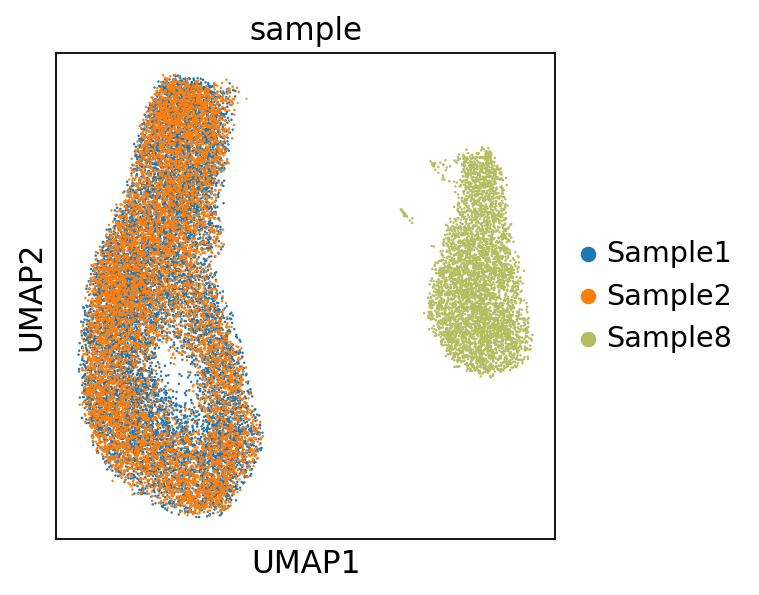

In [51]:
sc.pp.pca(adata2)
sc.pp.neighbors(adata2)
sc.tl.umap(adata2)
sc.pl.umap(adata2, color=['sample'])

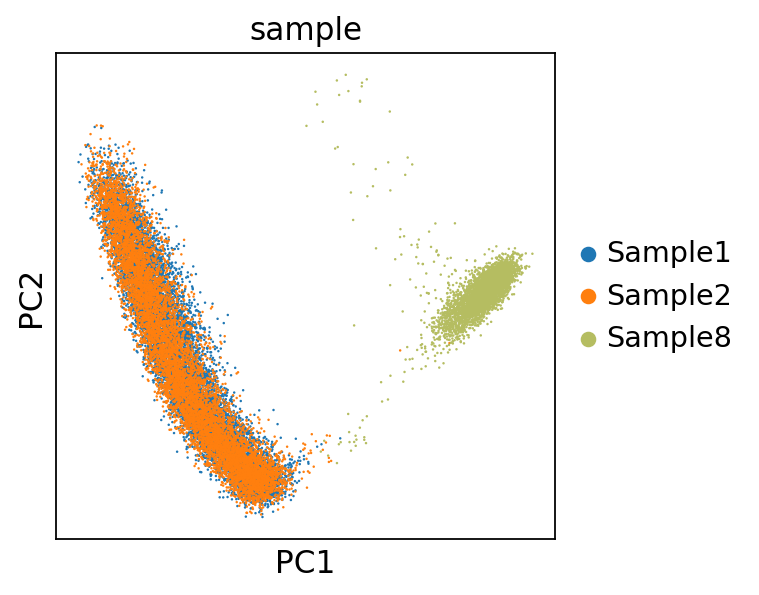

In [52]:
sc.pl.pca(adata2, color=['sample'])

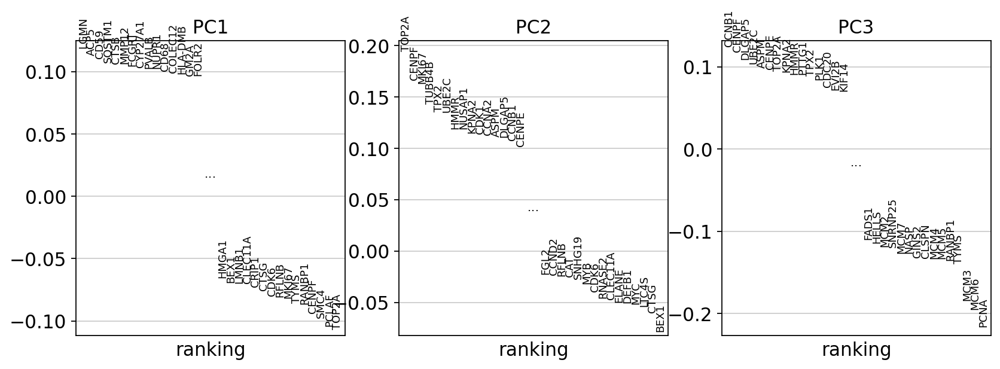

In [53]:
sc.pl.pca_loadings(adata2)

In [133]:
del adata2.uns['log1p']

ranking genes
    finished: added to `.uns['rank_genes_groups']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:01)


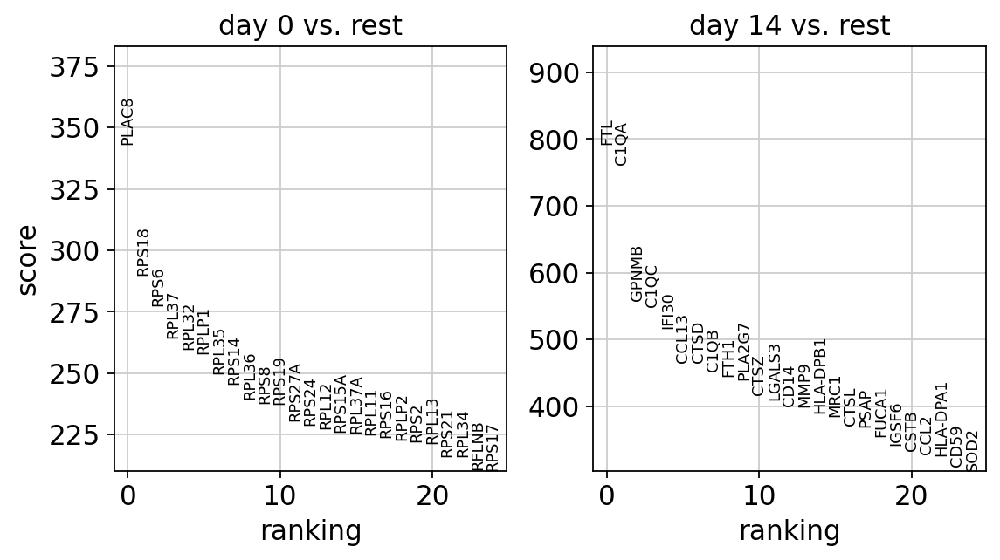

In [54]:
sc.tl.rank_genes_groups(adata2, 'timepoint', method='t-test', use_raw=True)
sc.pl.rank_genes_groups(adata2, n_genes=25, sharey=False, save='day0_vs_14.pdf')



    using 'X_pca' with n_pcs = 50
Storing dendrogram info using `.uns['dendrogram_timepoint']`


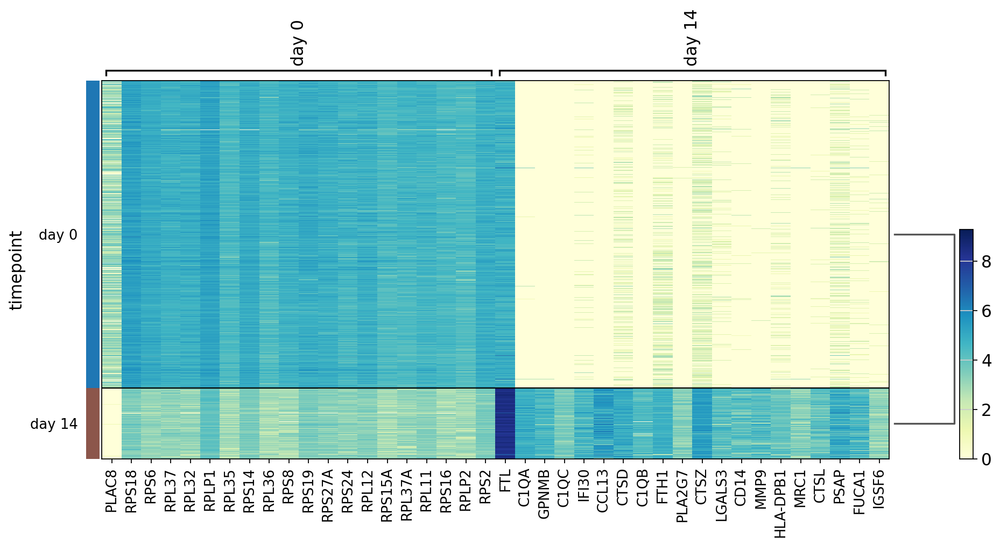

In [55]:
sc.pl.rank_genes_groups_heatmap(adata2, n_genes=20, save='day0_vs_14.pdf')

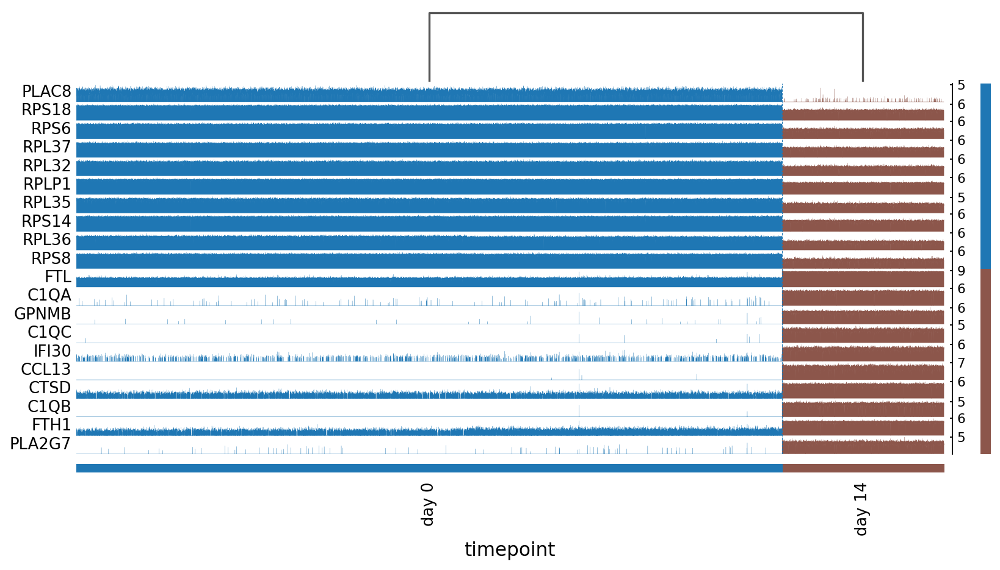

In [56]:
sc.pl.rank_genes_groups_tracksplot(adata2, save='day0_vs_14.pdf')

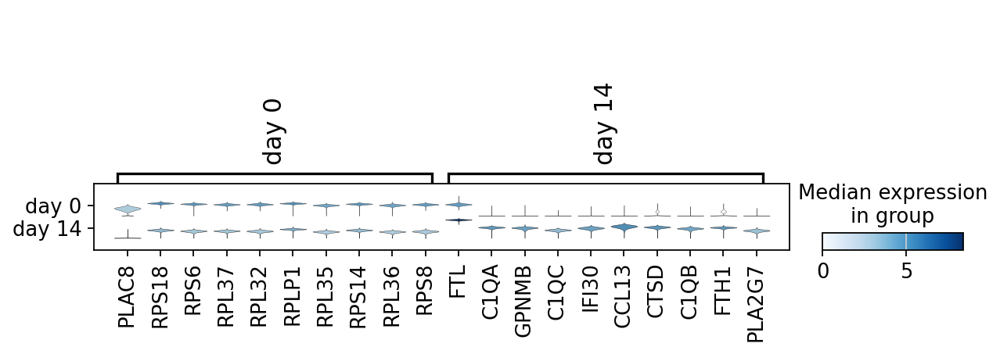

In [57]:
sc.pl.rank_genes_groups_stacked_violin(adata2, save='day0_vs_14.pdf')